# Imports

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import cv2
import sklearn
import os
import os
import numpy as np
import concurrent.futures
from skimage.feature import hog
from skimage import exposure
from skimage.feature import local_binary_pattern
from sklearn.ensemble import IsolationForest
from sklearn.decomposition import PCA
from PIL import Image
import sys

sys.path.insert(1, os.getenv("MOMAPS_HOME"))
print(f"MOMAPS_HOME: {os.getenv('MOMAPS_HOME')}")

from src.common.lib import image_metrics

%reload_ext autoreload
%autoreload 2
%aimport

%matplotlib inline

ModuleNotFoundError: No module named 'skimage'

# Utils

In [2]:
# Load images
def get_npy_files(path):
    npy_files = []
    for root, dirs, files in os.walk(path):
        for file in files:
            if file.endswith('.npy'):
                npy_files.append(os.path.join(root, file))
    return npy_files

def get_metrics(tile):
    snr = image_metrics.calculate_snr(tile)
    # Check contrast & Sharpness
    sharpness = image_metrics.calculate_image_sharpness(tile)
    contrast = image_metrics.calculate_image_contrast(tile)
    # Check var
    var = image_metrics.calculate_var(tile)
    # Check blurness:
    blurness = image_metrics.calculate_blurness(tile)    
    entropy = image_metrics.calculate_entropy(tile)
    sigma = image_metrics.calculate_sigma(tile)
    high_freq = image_metrics.calculate_high_freq_power(tile)
    # largest_area = calculate_largest_uniform_area(tile)
    # fractal_dim = calculate_fractal_dim(tile)
    return snr,sharpness,contrast,var,blurness, entropy, sigma,high_freq#,largest_area

def run_dim_reduction(dim_red, images, labels=None, show=True):
  # Perform PCA
  images = images.reshape(images.shape[0], -1)
  reduced = dim_red.fit_transform(images)
  
  if not show:
    return reduced
  
  if labels is None:
    plt.scatter(reduced[:,0], reduced[:,1])
    plt.show()
    return reduced
  
  
  labels_unique = np.unique(labels)
  
  for l in labels_unique:
    indexes = labels == l
    plt.scatter(reduced[indexes,0], reduced[indexes,1], alpha=0.5)
  plt.legend(labels_unique)
  plt.show()
  
  return reduced 

def plot_images(images, vmin=0,vmax=1000):
    for i in range(len(images)):
        fig, ax = plt.subplots(1, 2)
        ax[0].imshow(images[i,...,0])#, vmin=vmin,vmax=vmax)
        ax[0].set_title("Target")
        ax[1].imshow(images[i,...,1])#, vmin=vmin,vmax=vmax)
        ax[1].set_title("Nucleus")
        plt.show()

In [7]:
def _flat_list_of_lists(l):
    return [item for sublist in l for item in sublist]

def _load_and_stack_npy_files(folder, markers, is_tif=False):
        """
        This function loads all .npy files in a given folder and stacks them into one numpy array.
        It also returns the list of paths for the loaded files.
        """
        # print(f"Folder: {folder}")
        
        file_stacks = []
        file_paths = []
        extention = '.tif' if is_tif else '.npy'
        # for file in os.listdir(folder):
        for root, dirs, files in os.walk(folder):
            for file in files:
                if len(markers) > 0 and not any(string in root for string in markers):
                    continue
                
                file_path = os.path.join(root, file)
                # print(f"file_path: {file_path}")
                if file.endswith(extention):
                    data = np.array(cv2.imread(file_path, -1))[np.newaxis,...] if is_tif else np.load(file_path)
                    file_stacks.append(data)
                    file_paths.append([file_path] * len(data))
                    
        if len(file_stacks) == 0:
            return np.asarray(file_stacks), file_paths
        
        file_paths = _flat_list_of_lists(file_paths)
        
        return np.vstack(file_stacks), file_paths

def load_images(base_path, batches=[], cell_lines=[], conditions=[], markers=[], markers_level_from_base=2, is_tif=False):
    if batches is None:
        batches = []
    if cell_lines is None:
        cell_lines = []
    if conditions is None:
        conditions = []
    if markers is None:
        markers = []

    def get_level(path):
        splt = np.asarray(path.split(os.sep))
        splt = splt[splt!='']
        level = len(splt)
        return level

    def process_folders(base_path, level):
        """
        This function walks through the directory tree starting from base_path and collects 
        all folders that are at the specified level from the base. Level is 0-indexed.
        """
        
        target_folders = []
        for root, dirs, files in os.walk(base_path):
            if get_level(root) == level:
                is_valid = True
                if len(batches) > 0:
                    is_valid = is_valid and any(os.path.join(base_path,  string) in root for string in batches)
                if len(cell_lines) > 0:
                    is_valid = is_valid and any(string in root for string in cell_lines)
                if len(conditions) > 0:
                    is_valid = is_valid and any(string in root for string in conditions)
                    
                if not is_valid:
                    continue
                
                target_folders.extend([os.path.join(root, d) for d in dirs])
                # We don't want to dive deeper if we're already at the desired level
                dirs[:] = []
        return target_folders

    # Define the base path and the level you want to process
    # + 2 in order to get to the cell line level, + 1 to look at one level above so the subfolders would be the markers folders
    level = get_level(base_path) + markers_level_from_base + 1  # Change this to the level of subfolders you want to process

    # Get all target folders at the specified level
    folders_to_process = process_folders(base_path, level)

    # Use ProcessPoolExecutor to process each folder in parallel
    with concurrent.futures.ProcessPoolExecutor() as executor:
        # Create a future for each folder
        futures = {executor.submit(_load_and_stack_npy_files, folder, markers, is_tif): folder for folder in folders_to_process}
        
        # As each future completes, it will return the stacked arrays and file paths
        results = []
        paths = []
        for future in concurrent.futures.as_completed(futures):
            result, file_paths = future.result()
            if len(result) == 0:
                continue
            results.append(result)
            paths.extend(file_paths)

    # At this point, results contains all of the stacked numpy arrays from each folder
    # And paths contains all the file paths
    final_stack = np.vstack(results)
    final_paths = np.asarray(paths)

    return final_stack, final_paths

def load_processed_images(base_path, batches=[], cell_lines=[], conditions=[], markers=[]):
    return load_images(base_path, batches=batches, cell_lines=cell_lines, conditions=conditions, markers=markers, markers_level_from_base=2, is_tif=False)

def load_raw_images(base_path, batches=[], cell_lines=[], conditions=[], markers=[]):
    return load_images(base_path, batches=batches, cell_lines=cell_lines, conditions=conditions, markers=markers, markers_level_from_base=4, is_tif=True)


In [8]:
cell_lines = ['WT']
conditions = ['Untreated']#, 'stress']
markers = []#['NONO', 'G3BP1']
batches = ['batch7']#, 'batch8']#['batch6_16bit_no_downsample']

# cell_lines = ['WT']
# conditions = ['Untreated']#, 'stress']
# markers = []
# batches = ['batch6_16bit_no_downsample', 'batch3_16bit_no_downsample']

# Processed

# processed_base_path = '/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/'
# tiles, paths = load_processed_images(processed_base_path, batches, cell_lines, conditions, markers)
# print(tiles.shape, paths.shape)

# Raw

raw_base_path = '/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/'
tiles, paths = load_raw_images(raw_base_path, batches, cell_lines, conditions, markers)
# For removing bad (0,1) pixels and set the stage for splitting for tiles of 100x100 without resizing
tiles_no_border = tiles[:,12:-12,12:-12]
print(tiles.shape, paths.shape, tiles_no_border.shape)

(7200, 1024, 1024) (7200,) (7200, 1000, 1000)


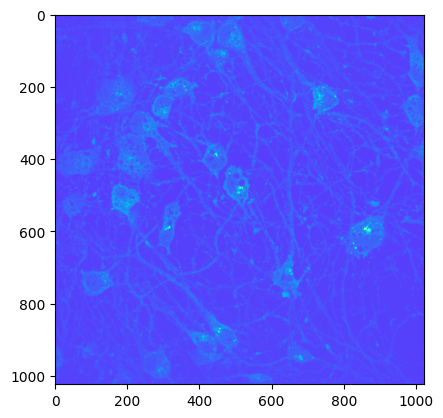

In [134]:
plt.imshow(tiles[100,:,:], cmap='rainbow', vmin=0, vmax=5000)

In [135]:
np.unique([p.split(os.sep)[-2] for p in paths])

array(['ANXA11', 'CD41', 'CLTC', 'Calreticulin', 'DAPI', 'DCP1A', 'FMRP',
       'FUS', 'G3BP1', 'GM130', 'KIF5A', 'LAMP1', 'NCL', 'NEMO', 'NONO',
       'PEX14', 'PML', 'PSD95', 'PURA', 'Phalloidin', 'SCNA', 'SQSTM1',
       'TDP43', 'TIA1', 'TOMM20', 'mitotracker'], dtype='<U12')

### Check 0 pixel

In [159]:
# series = pd.Series(tiles[0].reshape(-1,))
# print(series.describe())
# print(series.value_counts())
# len(series[series == 0])
a = []
for t in tiles:
    a.append(np.sum(t==0))
np.unique(a)

3.0

In [ ]:
np.unique(tiles[tiles<=400])

In [178]:
test = tiles[tiles<350]
test[0]==1
test = [(np.sum(t==0),np.sum(t==1)) for t in test]
np.unique(test)

True

In [184]:
test = tiles[tiles<300]
test = pd.Series(test.reshape(-1,))
test.value_counts()

0      194400
1       64800
290         5
298         5
293         4
299         4
292         4
296         3
294         3
286         2
289         2
288         2
295         2
285         2
282         2
287         1
Name: count, dtype: int64

In [ ]:
def check_values(tile, val):
    print(f"val: {val}")
    v = np.where(tile.reshape(-1,)==val)[0]
    rows=v//tile.shape[0]
    cols=v%tile.shape[1]
    locs = list(zip(rows, cols))
    print(f"Locations: {locs}")
    # print("Values:")
    # for loc in locs:
    #     row, col = loc
        # print(f"[{row}, {col}]: {tile[row,col]}",end=', ')
    # print()
    return locs

for i in range(50):
    tile_i = tiles[i]
    check_values(tile_i, 0)
    check_values(tile_i, 1)

### Isolation forest

In [84]:
def detect_outliers_with_isolation_forest(images, contamination=0.01, random_seed=1):
    def flatten_images(images):
        return images.reshape(images.shape[0], -1)

    # Flatten images to apply Isolation Forest
    flattened_images = flatten_images(images)
    
    # Train the model
    clf = IsolationForest(random_state=random_seed, contamination=contamination)  # 1% of data is outliers
    preds = clf.fit_predict(flattened_images)
    
    # Outliers are labeled as -1
    outlier_indices = np.where(preds == -1)[0]
    
    return outlier_indices


####### Feature extraction ########

def extract_hog_features(images):
    hog_features = []
    for image in images:
        fd, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16),
                            cells_per_block=(1, 1), visualize=True, multichannel=True)
        hog_features.append(fd)
    return np.array(hog_features)


def extract_lbp_features(images, P=8, R=1):
    lbp_features = []
    for image in images:
        lbp = local_binary_pattern(image, P, R, method="uniform")
        (hist, _) = np.histogram(lbp.ravel(), bins=np.arange(0, P + 3), range=(0, P + 2))
        hist = hist.astype("float")
        hist /= (hist.sum() + 1e-7)
        lbp_features.append(hist)
    return np.array(lbp_features)

def extract_edge_features(images):
    edge_features = []
    for image in images:
        edges = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=5)
        edge_features.append(edges.flatten())
    return np.array(edge_features)


# Load bad files

In [138]:
# a = cv2.imread('/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/deltaNLS_sort/batch2/WT/panelK/Untreated/rep2/Rab5/R11_w3confCy5_s581.tif', -1)
# a = np.array(a).reshape(-1,)
# min(a),max(a),np.mean(a)
# # plt.imshow(a, vmin=0, vmax=1000)

(0, 1201, 421.13979625701904)

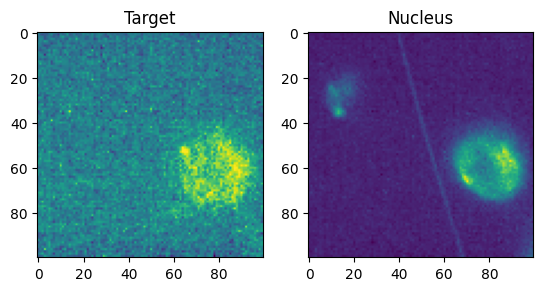

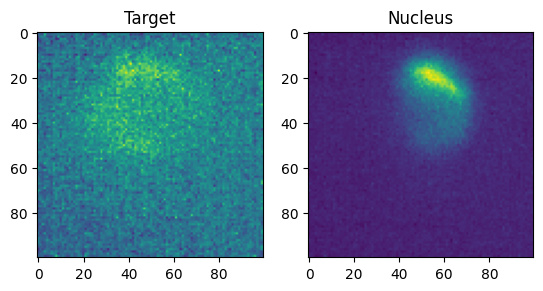

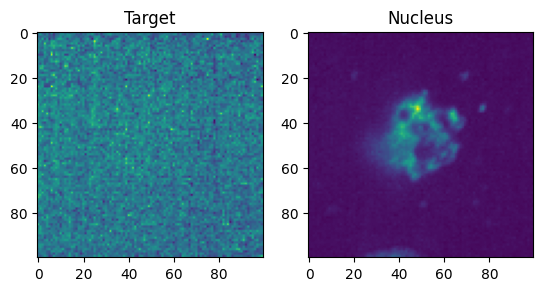

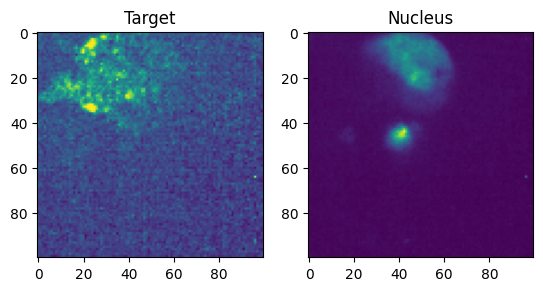

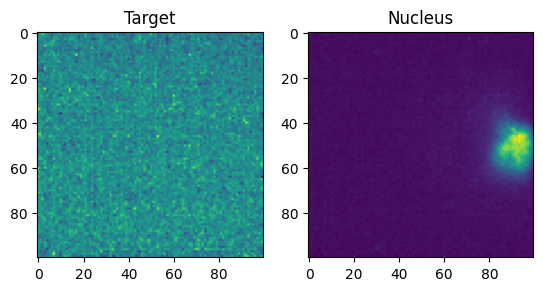

...

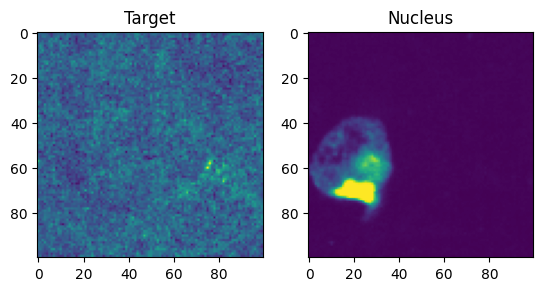

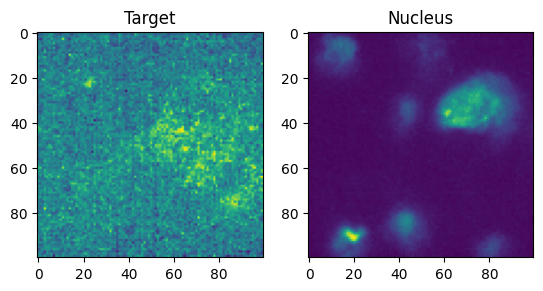

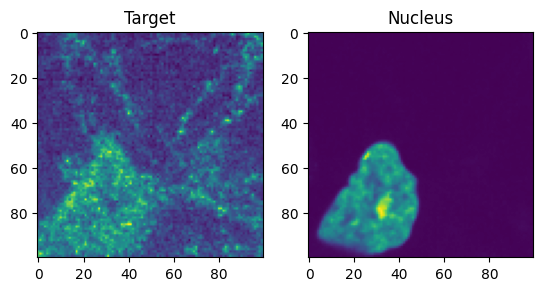

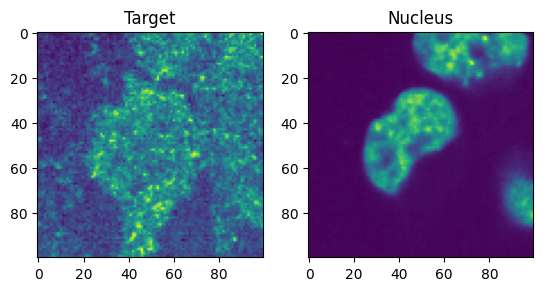

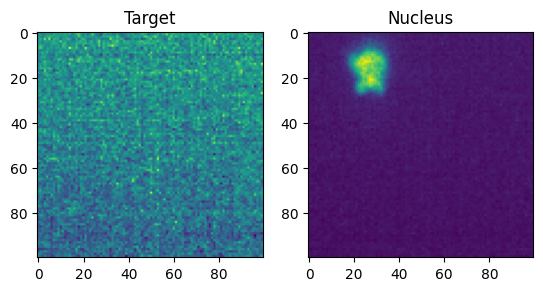

In [128]:
bad_tiles_paths = np.load("./bad_tiles_new2.npy", allow_pickle=True)
bad_tiles = np.stack([np.load(p.rsplit('_', 1)[0])[int(p.rsplit('_', 1)[1])] for p in bad_tiles_paths])
bad_tiles.shape

plot_images(bad_tiles)#, vmax=1)

In [42]:
# bad_path = "/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/deltaNLS/batch2_16bit_no_downsample/WT/Untreated/NONO/rep2_R11_w2confmCherry_s581_panelK_WT_processed.npy_1"
# bad_tiles_paths = np.load("./bad_tiles_new.npy", allow_pickle=True)
# bad_tiles_paths = [*bad_tiles_paths, bad_path]
# bad_tiles_paths

# np.save("./bad_tiles_new2", bad_tiles_paths)


# Main

(5, 100, 100, 2)


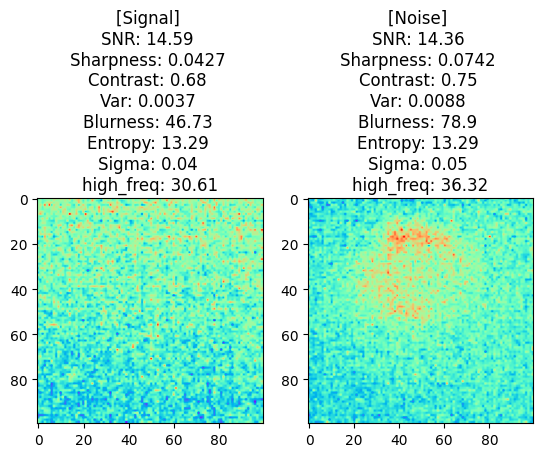

In [47]:
tile_index = 1
bad_tiles_tile_index = 1
channel_index = 0



site_path = "/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/deltaNLS/batch2_16bit_no_downsample/WT/Untreated/NONO/rep2_R11_w2confmCherry_s581_panelK_WT_processed.npy"#/rep1_R11_w3confCy5_s203_panelA_WT_processed.npy"
site = np.load(site_path)
# site = np.vstack([np.load(p) for p in get_npy_files(site_path)])
print(site.shape)

current_tile = site[tile_index,...,channel_index]
bad_current_tile = bad_tiles[bad_tiles_tile_index, ..., channel_index]

fig, ax = plt.subplots(1,2)

def plot_ax(ax, title, tile):
    # Plot tile
    ax.imshow(tile, cmap='rainbow')
    # # Check SNR
    # snr = calculate_snr(tile)
    # # Check contrast & Sharpness
    # sharpness = calculate_image_sharpness(tile)
    # contrast = calculate_image_contrast(tile)
    # blurness = calculate_blurness(tile)
    # # Check var
    # var = calculate_var(tile)
    
    snr,sharpness,contrast,var,blurness, entropy, sigma,high_freq = get_metrics(tile)
   
    ax.set_title(f"[{title}] \nSNR: {round(snr,2)} \nSharpness: {round(sharpness, 4)} \nContrast: {round(contrast, 2)} \nVar: {round(var, 4)} \nBlurness: {round(blurness, 2)} \nEntropy: {round(entropy, 2)} \nSigma: {round(sigma, 2)} \nhigh_freq: {round(high_freq, 2)}")

plot_ax(ax[0], 'Signal', current_tile)
plot_ax(ax[1], 'Noise', bad_current_tile)

# Check PCA
# Check isolation forest
plt.show()

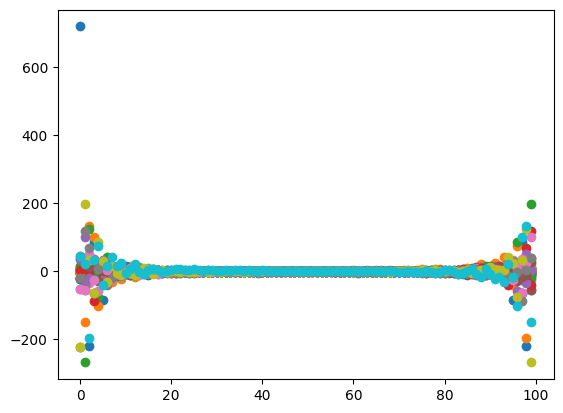

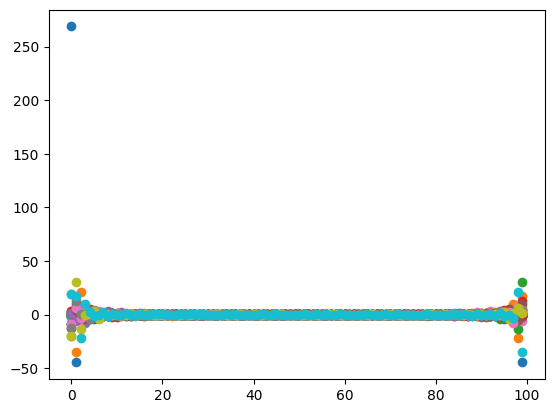

In [214]:
# calculate_high_low_freq_ratio(current_tile, 10), calculate_high_low_freq_ratio(bad_current_tile, 10)
f = np.fft.fft2(site[0,...,1])

for i in range(len(f)):
    plt.scatter(np.arange(len(f)), np.real(f)[:,i])
    
plt.show()

f = np.fft.fft2(bad_tiles[0, ..., 1])

for i in range(len(f)):
    plt.scatter(np.arange(len(f)), np.real(f)[:,i])
    


In [9]:
from concurrent.futures import ProcessPoolExecutor
import skimage 

def rescale_intensity(img_current_channel):
    """Return image after stretching or shrinking its intensity levels.

    The desired intensity range of the input and output, in_range and out_range respectively, 
    are used to stretch or shrink the intensity range of the input image
    
    see: https://scikit-image.org/docs/stable/api/skimage.exposure.html#skimage.exposure.rescale_intensity
    
    Args:
        img_current_channel (numpy ndarray): the image to scale

    Returns:
        img_scaled (numpy ndarray): image in scale of [0,1] after rescaling
    """
    
    vmin, vmax = np.percentile(img_current_channel, q=(0.5, 99.9))
    img_scaled = skimage.exposure.rescale_intensity(
                                                    img_current_channel,
                                                    in_range=(vmin, vmax),
                                                    out_range=np.float32
        )
    return img_scaled

# Assuming get_metrics is a function that computes the metrics
def process_tile(quality, tile, path, is_raw=False):
    if is_raw:
        vals = get_metrics(tile)
        return [quality, path] + list(vals)
    
    t0 = rescale_intensity(tile[...,0])
    t1 = rescale_intensity(tile[...,1])
    snr0, sharpness0, contrast0, var0, blurness0, entropy0, sigma0, high_freq0 = get_metrics(t0)
    snr1, sharpness1, contrast1, var1, blurness1, entropy1, sigma1,high_freq1 = get_metrics(t1)
    
    return [quality, path, snr0, sharpness0, contrast0, var0, blurness0, entropy0, sigma0,high_freq0,
            snr1, sharpness1, contrast1, var1, blurness1, entropy1, sigma1, high_freq1]
    
# Function to process each quality category in parallel
def process_quality(quality, data, paths, is_raw=False):
    with ProcessPoolExecutor() as executor:
        # Schedule the process_tile function to be called on each tile
        results = list(executor.map(process_tile, [quality] * len(data), data, paths, [is_raw] * len(data)))
    return results

qualities = ['Normal']#, 'Bad']
datasets = [tiles_no_border]#, bad_tiles]
paths_list = [paths]#, bad_tiles_paths]
is_raw = True

# Prepare the data for processing
all_results = []
for quality, data, path in zip(qualities, datasets, paths_list):
    all_results.extend(process_quality(quality, data, path, is_raw))

# # Adding the ID column
# all_results = [[i] + row for i, row in enumerate(all_results)]

# Define the columns
columns = ["Quality", "Path", "Target_SNR", "Target_Sharpness", "Target_Contrast", "Target_Var",
           'Target_Blurness', "Target_Entropy", "Target_Sigma", "Target_HighFreq", "DAPI_SNR", "DAPI_Sharpness",
           "DAPI_Contrast", "DAPI_Var", 'DAPI_Blurness', "DAPI_Entropy", "DAPI_Sigma", "DAPI_HighFreq"]
if is_raw:
    columns = [c for c in columns if 'DAPI' not in c]

# Create the DataFrame
df = pd.DataFrame(all_results, columns=columns)
df

/tmp/ipykernel_228586/1514355999.py:59: RuntimeWarning: overflow encountered in scalar add
  contrast = (max_intensity - min_intensity) / (max_intensity + min_intensity)
/tmp/ipykernel_228586/1514355999.py:59: RuntimeWarning: overflow encountered in scalar add
  contrast = (max_intensity - min_intensity) / (max_intensity + min_intensity)
/tmp/ipykernel_228586/1514355999.py:59: RuntimeWarning: overflow encountered in scalar add
  contrast = (max_intensity - min_intensity) / (max_intensity + min_intensity)
/tmp/ipykernel_228586/1514355999.py:59: RuntimeWarning: overflow encountered in scalar add
  contrast = (max_intensity - min_intensity) / (max_intensity + min_intensity)
/tmp/ipykernel_228586/1514355999.py:59: RuntimeWarning: overflow encountered in scalar add
  contrast = (max_intensity - min_intensity) / (max_intensity + min_intensity)
/tmp/ipykernel_228586/1514355999.py:59: RuntimeWarning: overflow encountered in scalar add
  contrast = (max_intensity - min_intensity) / (max_intensi

,Quality,Path,Target_SNR,Target_Sharpness,Target_Contrast,Target_Var,Target_Blurness,Target_Entropy,Target_Sigma,Target_HighFreq
0,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,7.225394,22094.442162,0.933650,52939.454736,3583669766,8.386904,14.208865,234.646664
1,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,9.315562,19090.831830,0.892601,32932.292929,3712469201,8.475937,15.249418,231.758071
2,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,7.616702,16125.834280,0.929303,43374.573503,2656156364,7.993658,12.177896,231.706042
3,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,7.317516,20095.741240,0.936124,52462.644694,3543270392,8.416520,15.104837,233.374451
4,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,8.110722,19185.990910,0.898857,42624.103072,3344314436,8.382119,14.406192,233.234897
...,...,...,...,...,...,...,...,...,...,...
7195,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,24.441266,3003.532916,0.774464,672.544496,355047135,6.371006,9.977866,200.759985
7196,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,18.862363,6310.996803,0.955043,2420.718427,356845940,6.439314,9.570386,217.569090
7197,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,20.576185,5119.685813,0.928177,1634.595726,354521835,6.408229,9.643567,213.159031
7198,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,23.375906,3154.769262,0.865952,860.046916,363999854,6.466695,9.891378,202.857675


In [144]:
df.to_csv("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/b7b8_metrics_for_outliers_with_rescaleInt.csv")

In [10]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_scaled = df.copy()
df_scaled.iloc[:,2:] = scaler.fit_transform(df.iloc[:,2:])
df_scaled

,Quality,Path,Target_SNR,Target_Sharpness,Target_Contrast,Target_Var,Target_Blurness,Target_Entropy,Target_Sigma,Target_HighFreq
0,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.412319,0.049878,0.001566,0.030710,0.494752,0.628751,0.318492,0.665628
1,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.467564,0.042647,0.001464,0.019060,0.513270,0.650839,0.368639,0.632373
2,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.422662,0.035510,0.001555,0.025140,0.361405,0.531192,0.220614,0.631774
3,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.414754,0.045066,0.001572,0.030432,0.488944,0.636098,0.361671,0.650982
4,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.435719,0.042877,0.001480,0.024703,0.460341,0.627564,0.328001,0.649375
...,...,...,...,...,...,...,...,...,...,...
7195,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.867347,0.003923,0.001172,0.000276,0.030578,0.128633,0.114590,0.275509
7196,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.719892,0.011884,0.001619,0.001293,0.030836,0.145579,0.094952,0.469023
7197,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.765190,0.009017,0.001553,0.000836,0.030502,0.137867,0.098479,0.418253
7198,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0.839189,0.004287,0.001398,0.000385,0.031865,0.152372,0.110421,0.299659


In [147]:
# marker_to_select = 'G3BP1'

# df_filtered = df
# df_filtered = df.loc[df['Path'].str.contains(marker_to_select)]

# print(df_filtered['Target_SNR'].describe())
# print(df_filtered['Target_Entropy'].describe())

count    200.000000
mean      17.138630
std        1.067954
min       14.817688
25%       16.405580
50%       17.080465
75%       17.738651
max       21.554810
Name: Target_SNR, dtype: float64
count    200.000000
mean       6.820593
std        0.161926
min        6.412424
25%        6.715879
50%        6.808154
75%        6.926909
max        7.249016
Name: Target_Entropy, dtype: float64


In [222]:
# df.columns

Index(['Quality', 'Path', 'Target_SNR', 'Target_Sharpness', 'Target_Contrast',
       'Target_Var', 'Target_Blurness', 'Target_Entropy', 'Target_Sigma',
       'Target_HighFreq'],
      dtype='object')

(7200, 10)


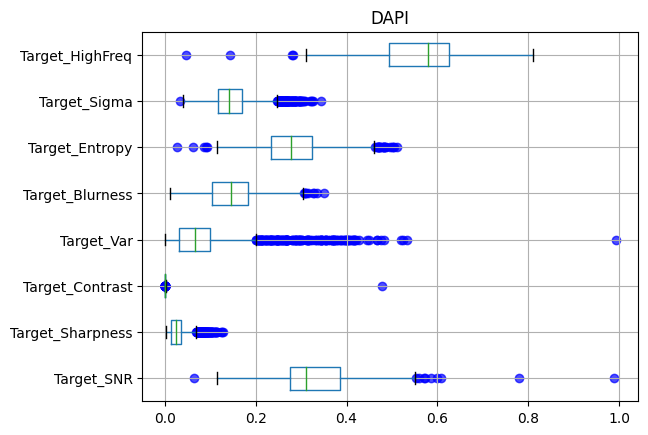

In [12]:
def get_outliers(df, feature, split=False):
    # Calculate Q1, Q3, and IQR
    Q1 = df[feature].quantile(0.25)
    Q3 = df[feature].quantile(0.75)
    IQR = Q3 - Q1
    
    lower = df[feature] < Q1 - 1.5* IQR
    higher = df[feature] > Q3 + 1.5*IQR
    if split:
        # Determine outliers using IQR
        outliers_lower = df[lower]
        outliers_higher = df[higher]
        return outliers_lower, outliers_higher
    
    # Determine outliers using IQR
    outliers = df[(lower ) | (higher)]
    
    return outliers

def color_outliers(ax, df, feature, labels_col):
    outliers = get_outliers(df, feature)
    colors = {'Normal':'blue', 'Bad':'red'}
    alpha = {'Normal':0.7, 'Bad':0.5}
    # Plot each outlier with a different color based on its label
    for label in df[labels_col].unique():
        label_outliers = outliers[outliers[labels_col] == label]
        feature_number = np.where(df.columns[2:] == feature)[0][0] + 1
        ax.scatter(label_outliers[feature], [feature_number]*len(label_outliers), color=colors[label], alpha=alpha[label])

print(df.shape)


markers = np.unique([p.split(os.sep)[-2] for p in paths])

for m in ['DAPI']:
    # print(m)
    df_filtered = df_scaled
    df_filtered = df_filtered.loc[df['Path'].str.contains(m)]

    ax = df_filtered.iloc[:,2:].boxplot(vert=False, showfliers=False)

    for feature in df_filtered.columns[2:]:
        color_outliers(ax, df_filtered, feature, 'Quality')
    plt.title(m)
    plt.show()

Bad:
- Target_HighFreq - Low
- Target_Sigma - Low
- Target_Entropy - Low
- Target_Blurness - Low
- Target_Var - Low??
- Target_Contrast - Low
- Target_Sharpness - High??
- Target_SNR - High

PURA Target_HighFreq


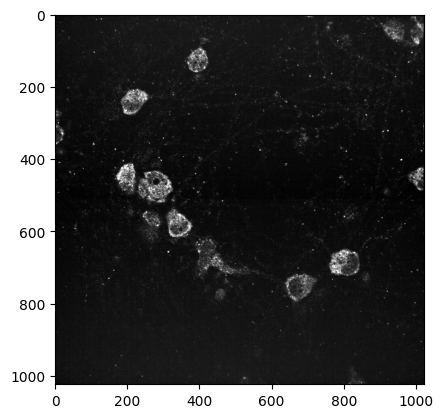

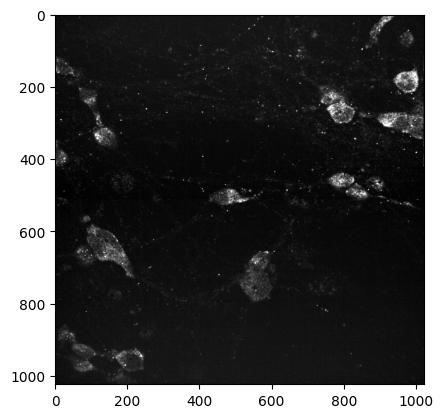

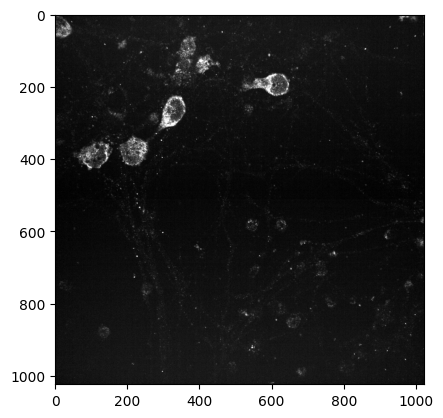

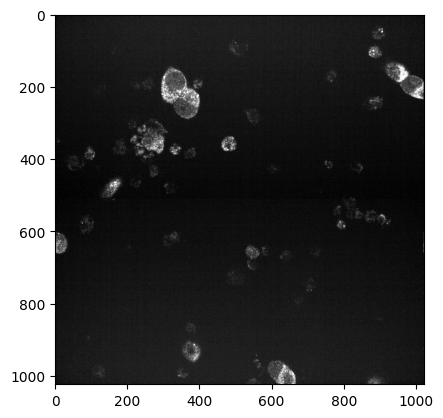

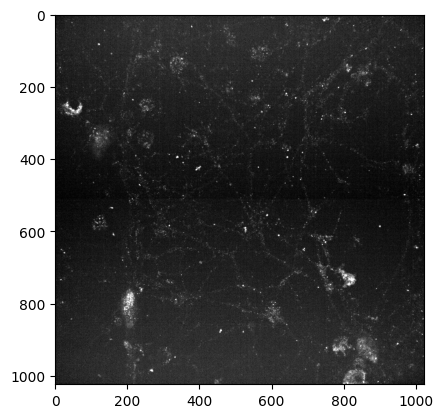

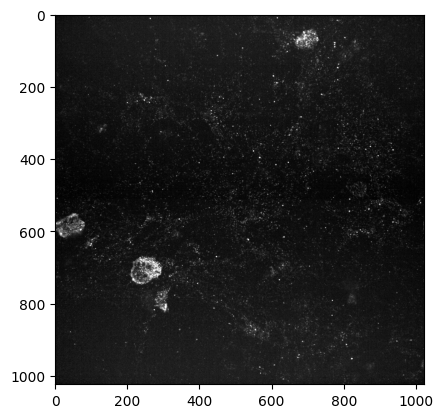

In [27]:
marker_to_select = 'PURA'
feature_to_select = 'Target_HighFreq'
print(marker_to_select, feature_to_select)

df_filtered = df_scaled
df_filtered = df_filtered.loc[df_scaled['Path'].str.contains(marker_to_select)]
target_bluriness_outliers_lower, target_bluriness_outliers_higher = get_outliers(df_filtered, feature_to_select,split=True)
# plot_images(site[target_bluriness_outliers['ID']])
# print(target_bluriness_outliers.shape)
# target_bluriness_outliers = target_bluriness_outliers[:100]

target_bluriness_outliers = target_bluriness_outliers_lower # target_bluriness_outliers_higher

c = 0 
for rowid, outlier in target_bluriness_outliers.iterrows():
    if c >= 10:
        break
    c += 1
    if rowid >= len(tiles):
        break
    img = tiles[rowid]
    img = rescale_intensity(img)
    marker = outlier['Path'].split(os.sep)[-2]
    if marker != marker_to_select:
        continue
    plt.imshow(img, vmin=0, vmax=1, cmap='gray')
    plt.show()
    # fig, ax = plt.subplots(1, 2)
    # ax[0].imshow(img[...,0])
    # ax[0].set_title(f"{marker} - Target blurness: {round(outlier['Target_Blurness'], 2)}")
    # ax[1].imshow(img[...,1])
    # ax[1].set_title("Nucleus")
    # plt.show()

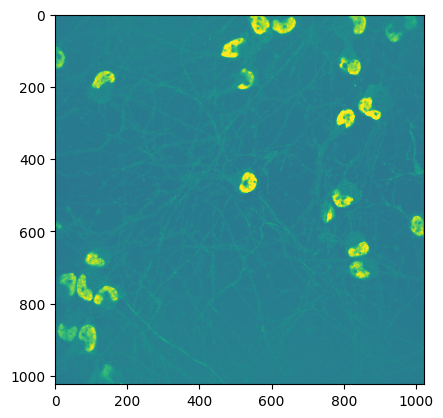

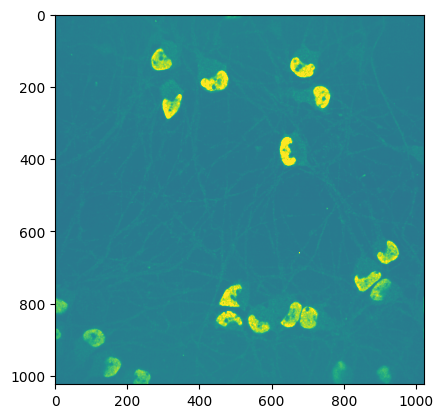

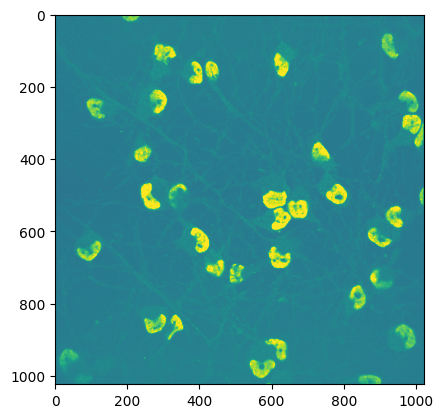

In [118]:
# "Normal" (non outliers)
#
marker_to_select = 'NONO'
n_samples = 3

df_filtered = df
df_filtered = df.loc[df['Path'].str.contains(marker_to_select)]
outliers_ind = list(get_outliers(df_filtered, 'Target_Blurness').index)
for rowid, item in df_filtered.iloc[:n_samples,:].iterrows():
    if rowid in outliers_ind:
        continue
    if rowid >= len(tiles):
        break
    img = tiles[rowid]
    marker = item['Path'].split(os.sep)[-2]
    if marker != marker_to_select:
        continue
    plt.imshow(img,vmin=0, vmax=1000)
    plt.show()

In [92]:
df_scaled.columns

Index(['Quality', 'Path', 'Target_SNR', 'Target_Sharpness', 'Target_Contrast',
       'Target_Var', 'Target_Blurness', 'Target_Entropy', 'Target_Sigma',
       'Target_HighFreq'],
      dtype='object')

Bad:
- Target_HighFreq - Low
- Target_Sigma - Low
- Target_Entropy - Low
- Target_Blurness - Low
- Target_Var - Low??
- Target_Contrast - Low
- Target_Sharpness - High??
- Target_SNR - High

In [140]:
df_scaled_bool = df_scaled.iloc[:,:2].copy()
new_columns = [f"{c}_bool" for c in df_scaled.columns[2:]]
df_scaled_bool = df_scaled_bool.assign(**{col: 0 for col in new_columns})
markers = np.unique([p.split(os.sep)[-2] for p in paths])
features = df_scaled.columns[2:]
features_bad_extreme_values = [1,1,0,0,0,0,0,0] #1-high, 0-low

for m in markers:
    for f, bad_value in zip(features, features_bad_extreme_values):
        print(m, f, bad_value)
        df_filtered = df_scaled
        df_filtered = df_filtered.loc[df_scaled['Path'].str.contains(m)]
        outliers_lower, outliers_higher = get_outliers(df_filtered, f,split=True)
        outliers_lower_ind, outliers_higher_ind = outliers_lower.index, outliers_higher.index
        bad_indxes = outliers_lower_ind if bad_value == 0 else outliers_higher_ind
        df_scaled_bool.loc[bad_indxes.tolist(), f"{f}_bool"] = 1
            
df_scaled_bool

ANXA11 Target_SNR 1
ANXA11 Target_Sharpness 1
ANXA11 Target_Contrast 0
ANXA11 Target_Var 0
ANXA11 Target_Blurness 0
ANXA11 Target_Entropy 0
ANXA11 Target_Sigma 0
ANXA11 Target_HighFreq 0
CD41 Target_SNR 1
CD41 Target_Sharpness 1
CD41 Target_Contrast 0
CD41 Target_Var 0
CD41 Target_Blurness 0
CD41 Target_Entropy 0
CD41 Target_Sigma 0
CD41 Target_HighFreq 0
CLTC Target_SNR 1
CLTC Target_Sharpness 1
CLTC Target_Contrast 0
CLTC Target_Var 0
CLTC Target_Blurness 0
CLTC Target_Entropy 0
CLTC Target_Sigma 0
CLTC Target_HighFreq 0
Calreticulin Target_SNR 1
Calreticulin Target_Sharpness 1
Calreticulin Target_Contrast 0
Calreticulin Target_Var 0
Calreticulin Target_Blurness 0
Calreticulin Target_Entropy 0
Calreticulin Target_Sigma 0
Calreticulin Target_HighFreq 0
DAPI Target_SNR 1
DAPI Target_Sharpness 1
DAPI Target_Contrast 0
DAPI Target_Var 0
DAPI Target_Blurness 0
DAPI Target_Entropy 0
DAPI Target_Sigma 0
DAPI Target_HighFreq 0
DCP1A Target_SNR 1
DCP1A Target_Sharpness 1
DCP1A Target_Contrast

,Quality,Path,Target_SNR_bool,Target_Sharpness_bool,Target_Contrast_bool,Target_Var_bool,Target_Blurness_bool,Target_Entropy_bool,Target_Sigma_bool,Target_HighFreq_bool
0,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0
1,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0
2,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0
3,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0
4,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...
129595,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0
129596,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0
129597,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0
129598,Normal,/home/labs/hornsteinlab/Collaboration/MOmaps/i...,0,0,0,0,0,0,0,0


In [141]:
iso_outlier_indices = detect_outliers_with_isolation_forest(df_scaled_bool.iloc[:,2:].to_numpy())
iso_outlier_indices

array([  1822,   1916,   4399, ..., 126931, 128265, 128331])

In [142]:
len(iso_outlier_indices)

1162

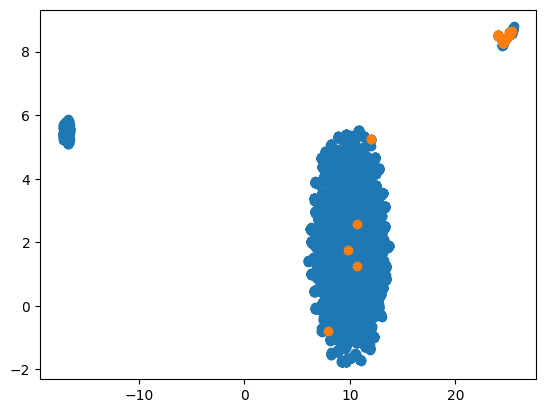

In [111]:
from umap import UMAP
reducer = UMAP(random_state=1)
umap_data = reducer.fit_transform(df_scaled_bool.iloc[:,2:])

plt.scatter(umap_data[:,0], umap_data[:,1])
plt.scatter(umap_data[iso_outlier_indices,0], umap_data[iso_outlier_indices,1])
# labels_unique = np.unique(df['Quality'])
# for l in labels_unique:
#     indexes = df.loc[df['Quality'] == l].index
    
# plt.legend(labels_unique)
plt.show()

In [125]:
# df_scaled_bool.loc[df_scaled_bool['Path'].str.contains('G3BP1')].index[:2].tolist()


[2000, 2001]

0.02293299995099997

In [ ]:
pp

/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch7/TDP43/panelI/Untreated/rep1/DAPI/R11_w1confDAPI_s402.tif


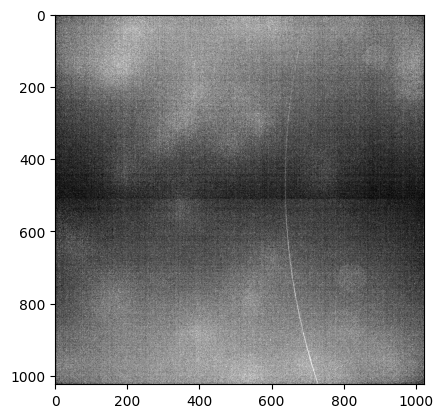

In [184]:
pp = df.loc[10062, 'Path']
print(pp)
pp = cv2.imread(pp, -1)
pp = rescale_intensity(pp)
plt.imshow(pp, cmap='gray')

10909


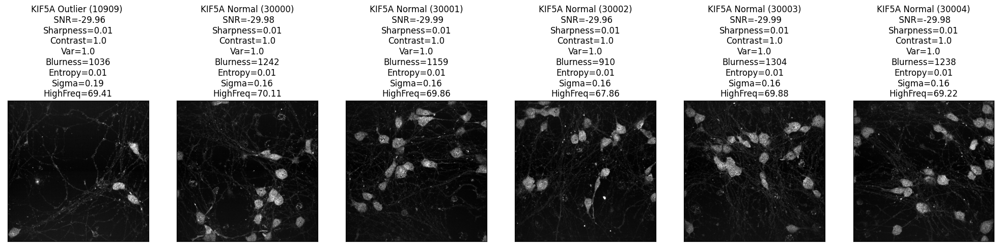

10997


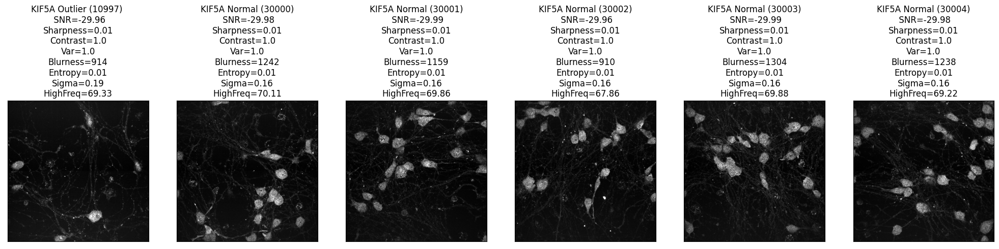

11003


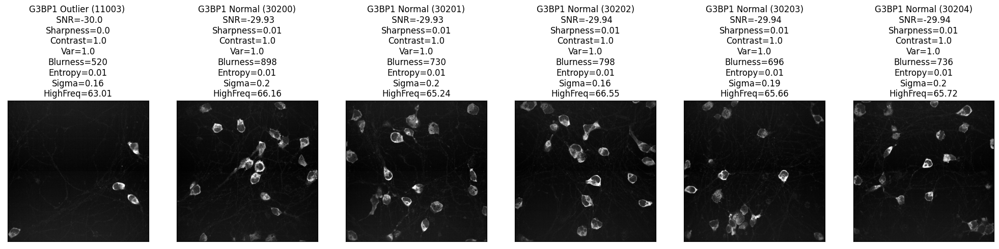

11006


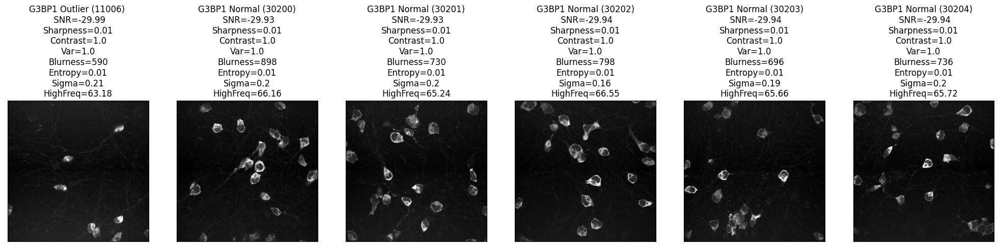

11044


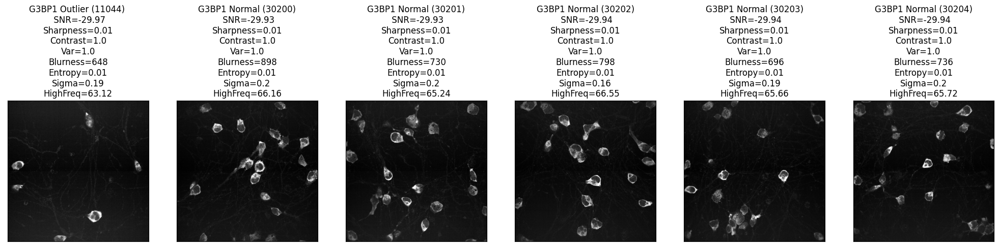

11045


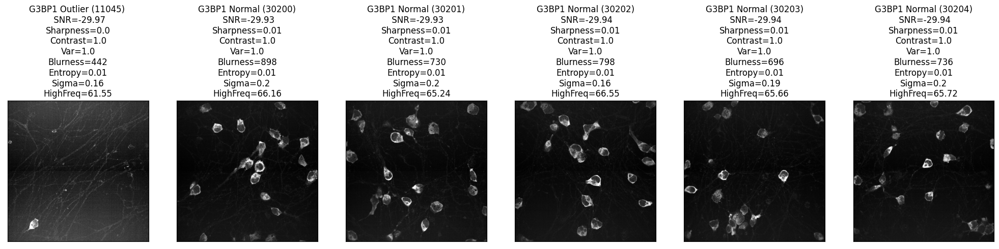

11046


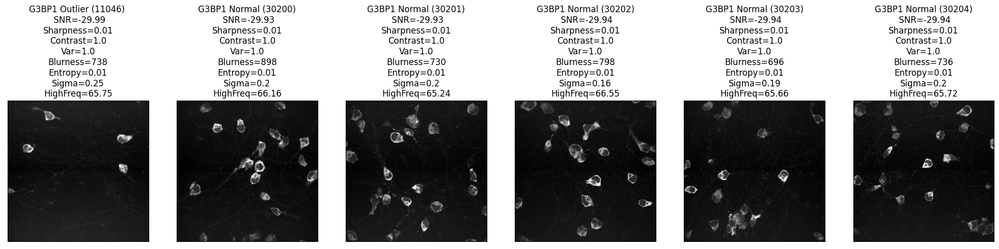

11062


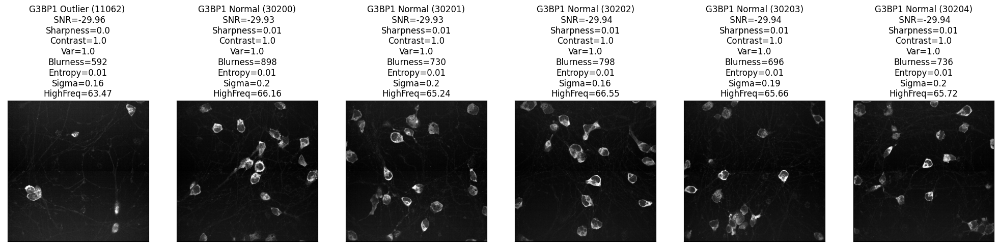

11067


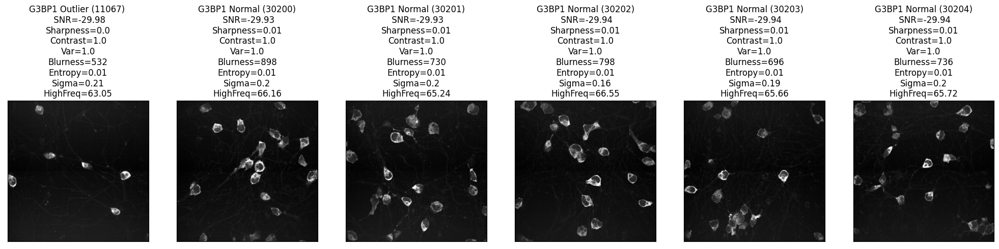

11070


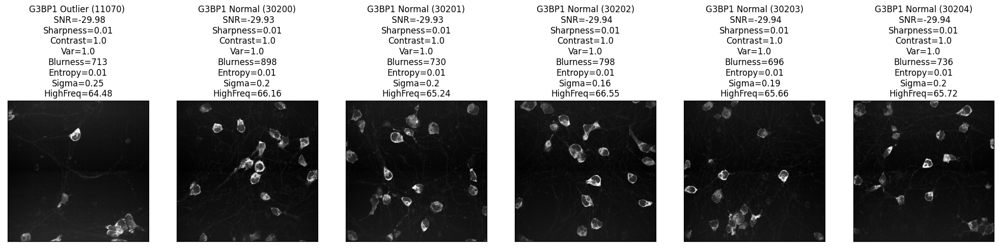

11075


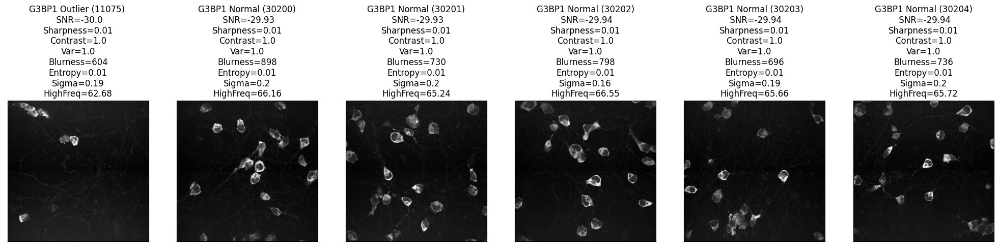

11420


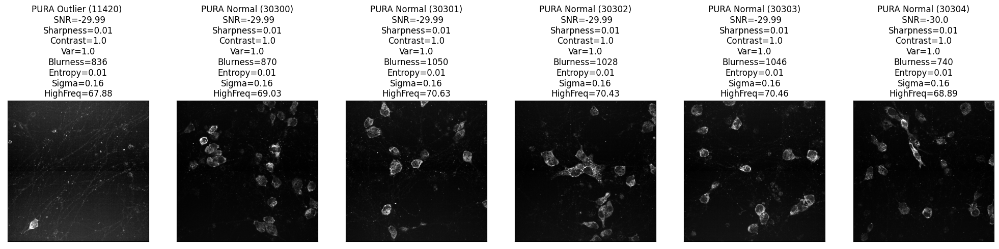

11456


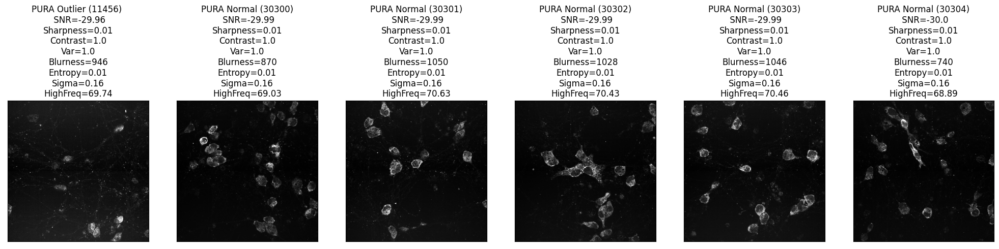

In [185]:
n_normal_images = 5
cell_line_to_take = 'WT'
condition_to_take = 'Untreated'

for ind in iso_outlier_indices[20:40]:
    fig, ax = plt.subplots(1,n_normal_images+1, figsize=(25,15))
    print(ind)
    if ind >= len(tiles_no_border):
        break
    img = tiles_no_border[ind]
    img = rescale_intensity(img)
    
    snr,sharpness,contrast,var,blurness, entropy, sigma,high_freq = get_metrics(img.astype(np.uint8))
    snr,sharpness,contrast,var,blurness, entropy, sigma,high_freq = round(snr,2),round(sharpness,2),round(contrast,2),round(var,2),round(blurness,2), round(entropy,2), round(sigma,2),round(high_freq,2)
    # marker = tiles['Path'].split(os.sep)[-2]
    # if marker != marker_to_select:
    #     continue
    marker_name = df_scaled_bool.loc[ind, 'Path'].split(os.sep)[-2]
    ax[0].set_title(f"{marker_name} Outlier ({ind}) \n SNR={snr}\nSharpness={sharpness}\nContrast={contrast}\nVar={contrast}\nBlurness={blurness}\nEntropy={entropy}\nSigma={sigma}\nHighFreq={high_freq}")
    ax[0].imshow(img, vmin=0, vmax=1, cmap='gray')
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    normal_images_indexes = df_scaled_bool.loc[~df.index.isin(iso_outlier_indices)].loc[df_scaled_bool['Path'].str.contains(marker_name) & df_scaled_bool['Path'].str.contains(cell_line_to_take) & df_scaled_bool['Path'].str.contains(condition_to_take)].index[:n_normal_images].tolist()
    for j, norm_ind in enumerate(normal_images_indexes):
        norm_img = tiles_no_border[norm_ind]
        norm_img = rescale_intensity(norm_img)
        snr,sharpness,contrast,var,blurness, entropy, sigma,high_freq = get_metrics(norm_img.astype(np.uint8))
        snr,sharpness,contrast,var,blurness, entropy, sigma,high_freq = round(snr,2),round(sharpness,2),round(contrast,2),round(var,2),round(blurness,2), round(entropy,2), round(sigma,2),round(high_freq,2)
        ax[j+1].set_title(f"{marker_name} Normal ({norm_ind})\n SNR={snr}\nSharpness={sharpness}\nContrast={contrast}\nVar={contrast}\nBlurness={blurness}\nEntropy={entropy}\nSigma={sigma}\nHighFreq={high_freq}")
        ax[j+1].imshow(norm_img, vmin=0, vmax=1, cmap='gray')
        ax[j+1].set_xticks([])
        ax[j+1].set_yticks([])
    plt.show()

---

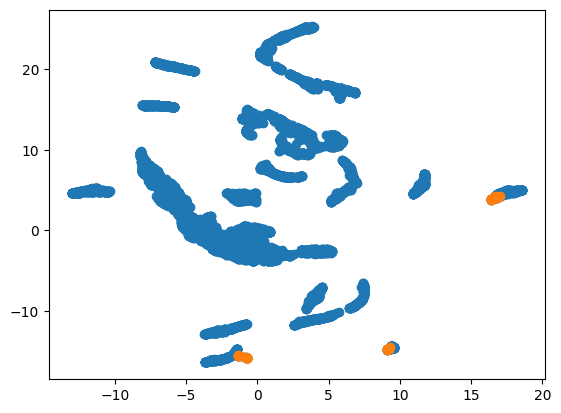

In [90]:
from umap import UMAP
reducer = UMAP(random_state=1)
umap_data = reducer.fit_transform(df_scaled.iloc[:,2:])

plt.scatter(umap_data[:,0], umap_data[:,1])
plt.scatter(umap_data[iso_outlier_indices,0], umap_data[iso_outlier_indices,1])
# labels_unique = np.unique(df['Quality'])
# for l in labels_unique:
#     indexes = df.loc[df['Quality'] == l].index
    
# plt.legend(labels_unique)
plt.show()

In [85]:
iso_outlier_indices = detect_outliers_with_isolation_forest(df_scaled.iloc[:,2:].to_numpy())
iso_outlier_indices

array([ 436,  982, 1294, 1703, 3004, 3009, 3018, 3022, 3051, 3074, 3078,
       3091, 3094, 4313, 4328, 4329, 4338, 4351, 4364, 4365, 4377, 6400,
       6405, 6411, 6412, 6428, 6429, 6438, 6439, 6442, 6443, 6457, 6458,
       6469, 6470, 6472, 6474, 6475, 6477, 6478, 6483, 6484, 6485, 6489,
       6491, 6811, 6814, 6823, 6825, 6828, 6843, 6845, 6846, 6847, 6857,
       6860, 6865, 6866, 6869, 6871, 6872, 6874, 6885, 6888, 6895, 6896,
       6899, 6909, 6932, 6936, 6969, 6975])

436


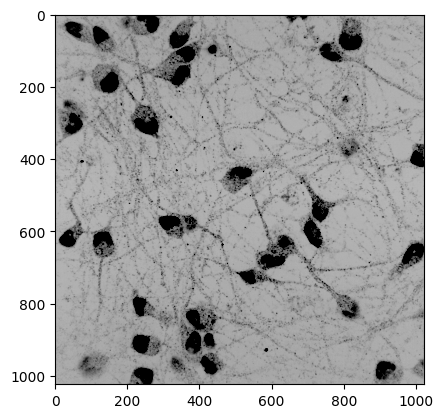

982


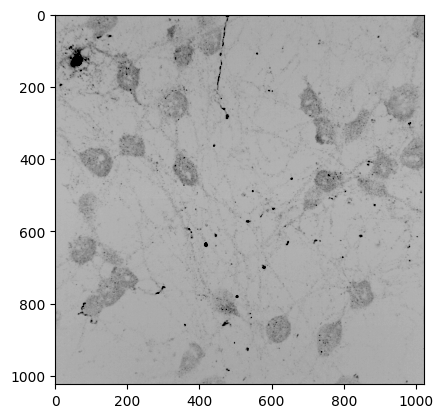

1294


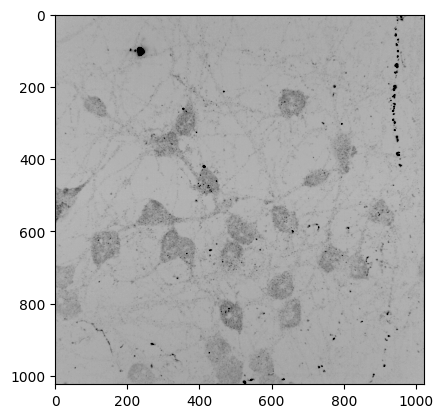

1703


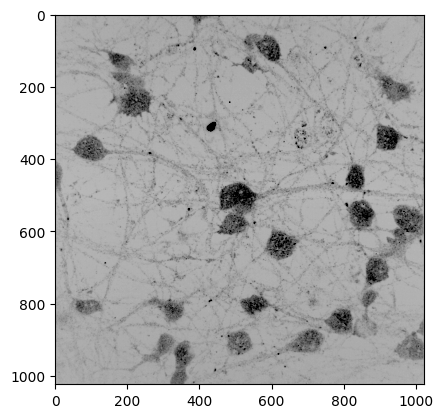

3004


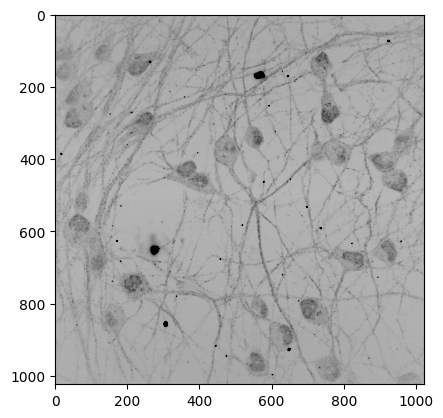

3009


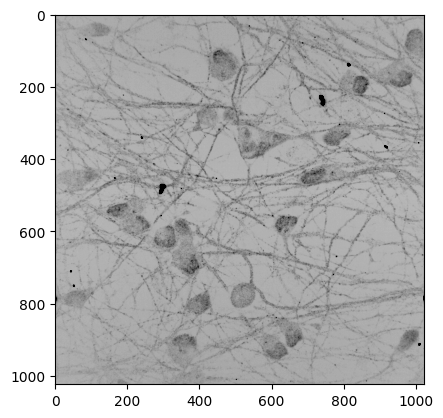

3018


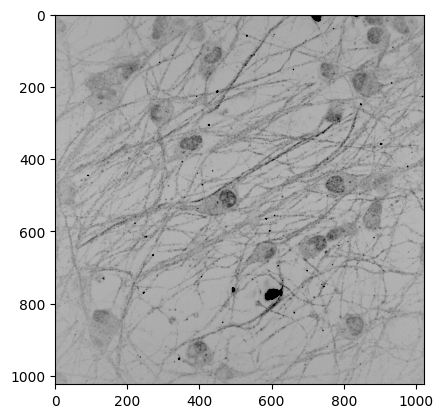

3022


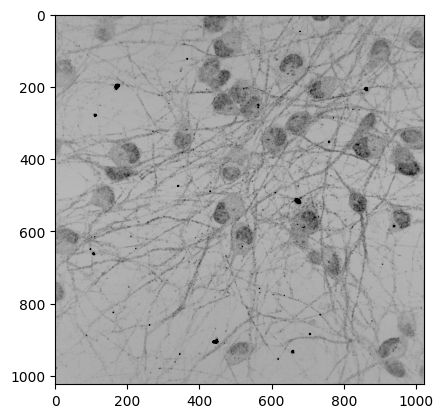

3051


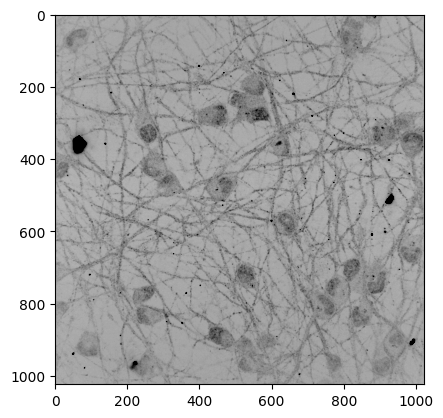

3074


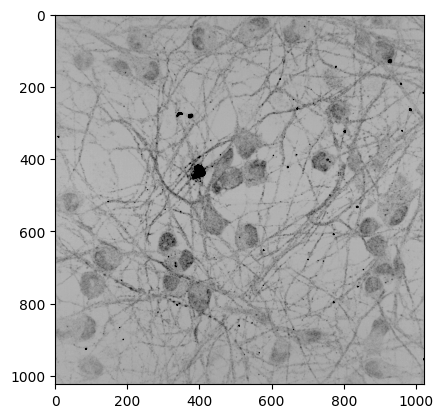

3078


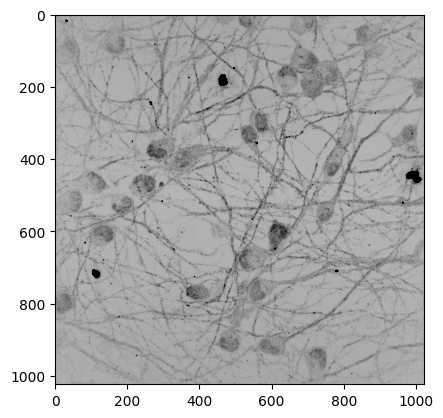

3091


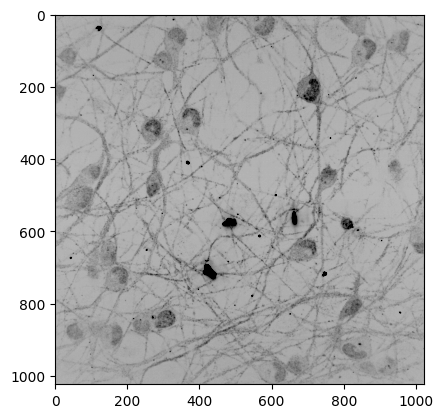

3094


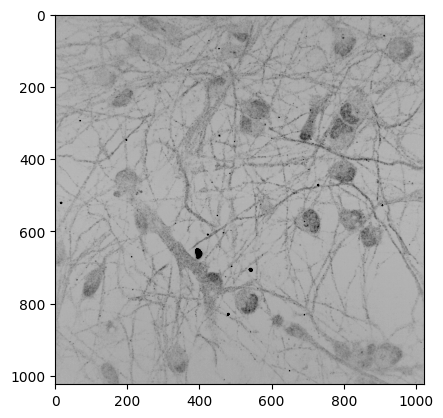

4313


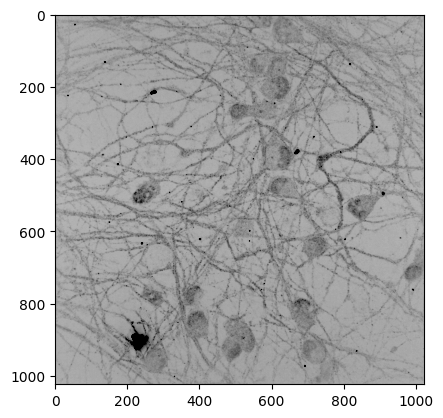

4328


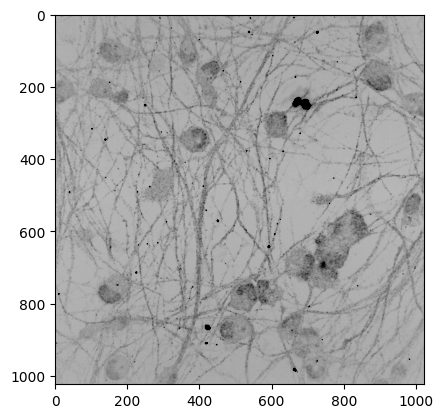

4329


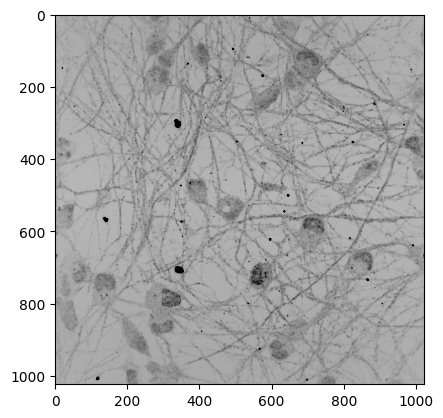

4338


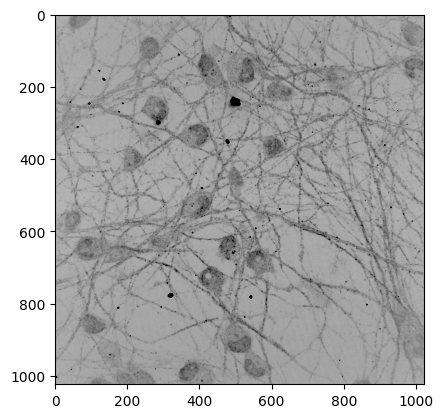

4351


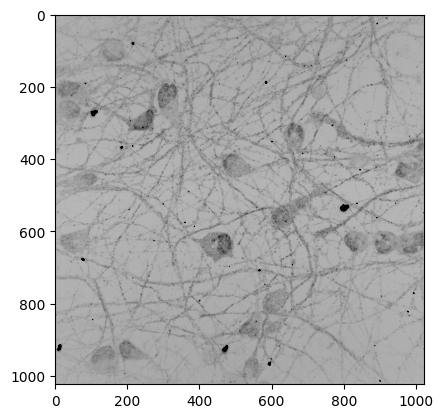

4364


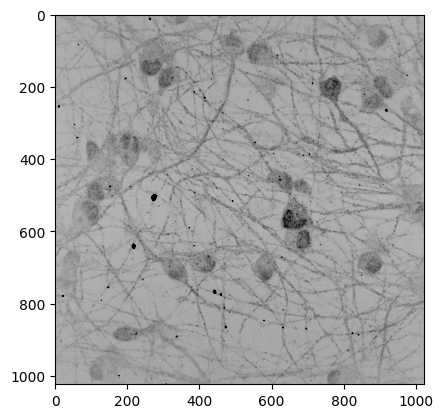

4365


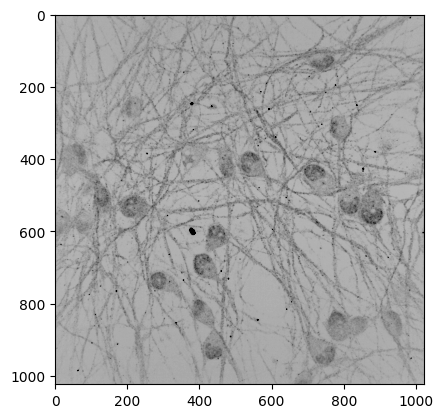

4377


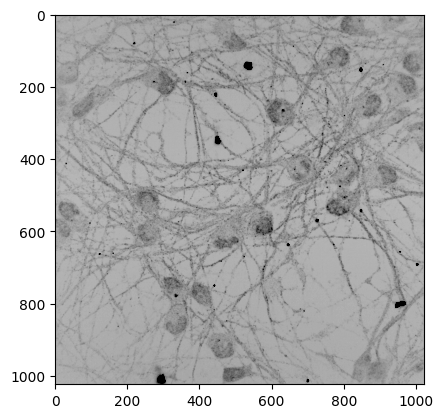

6400


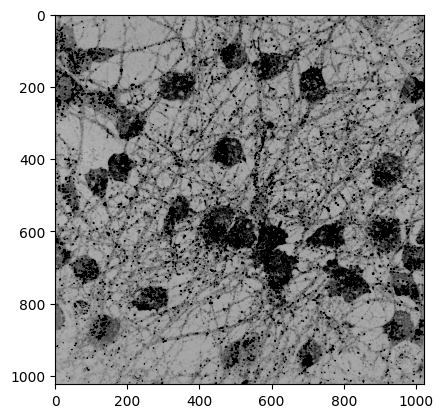

6405


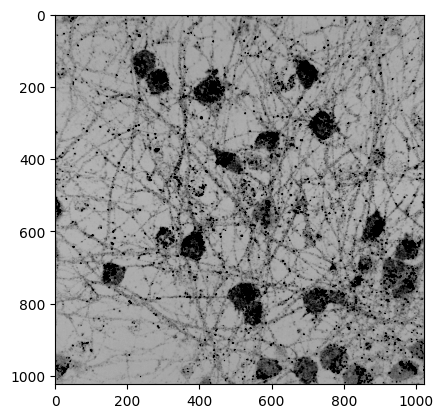

6411


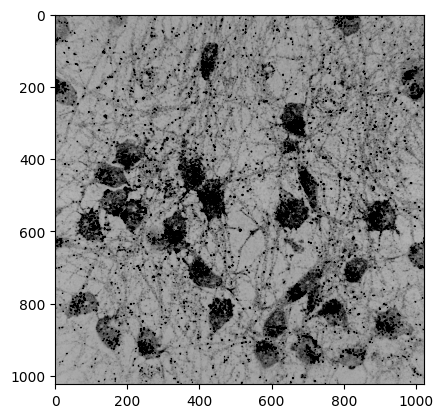

6412


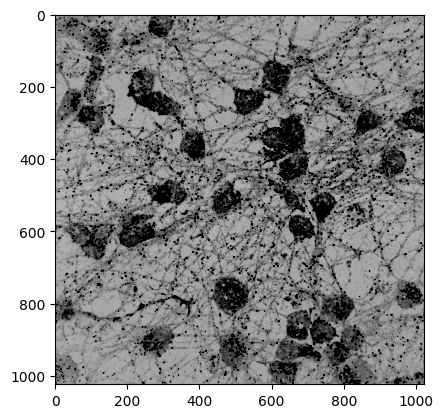

6428


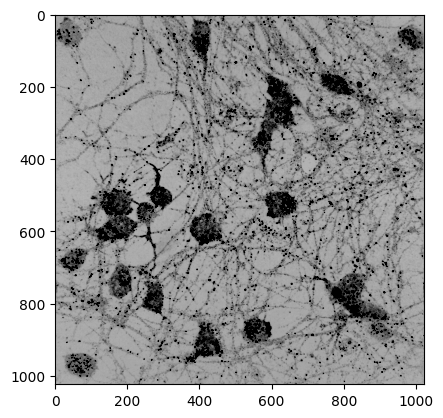

6429


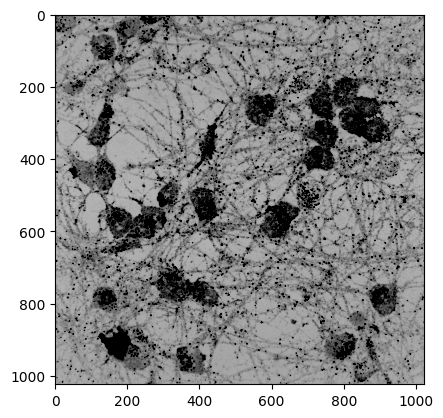

6438


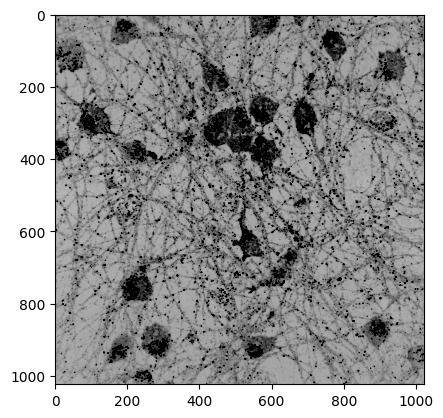

6439


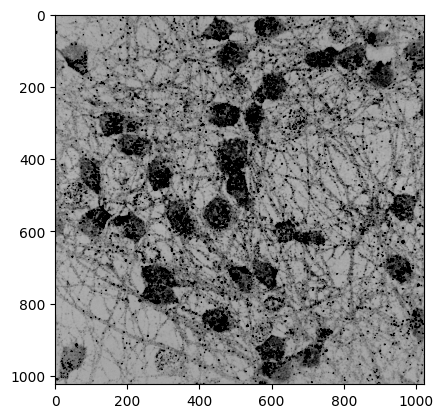

6442


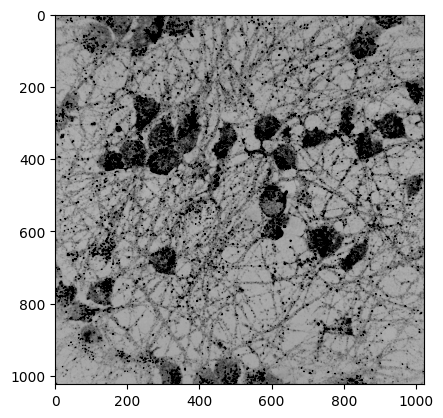

6443


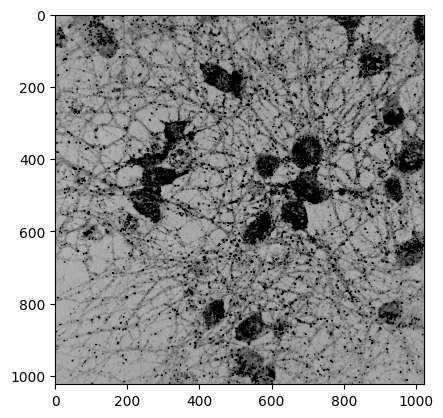

6457


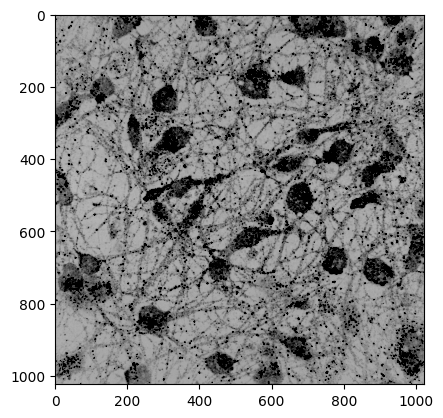

6458


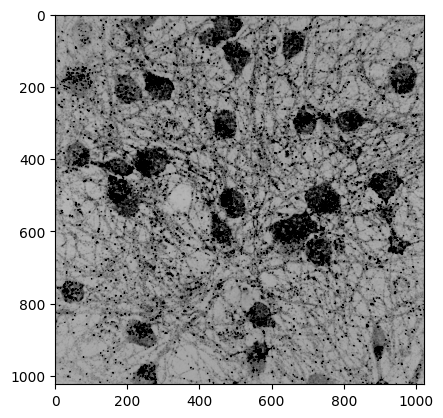

6469


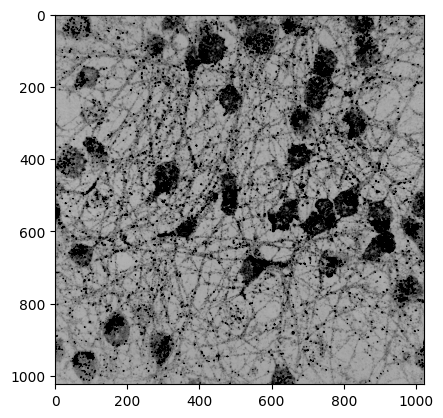

6470


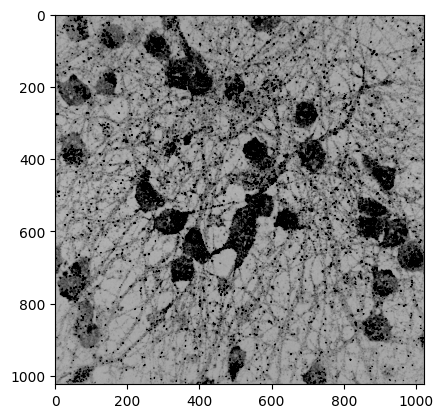

6472


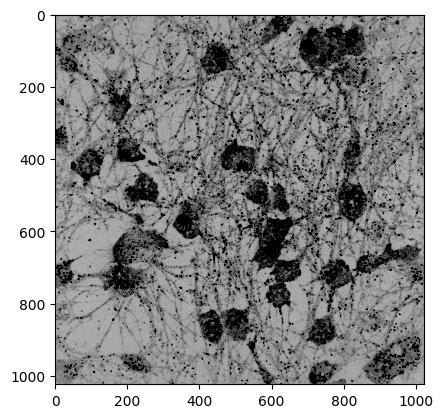

6474


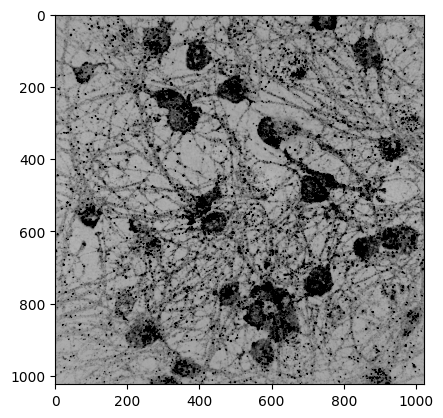

6475


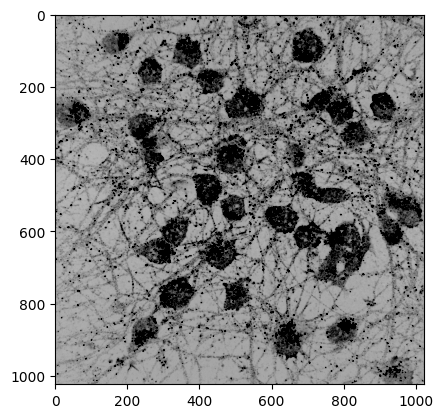

6477


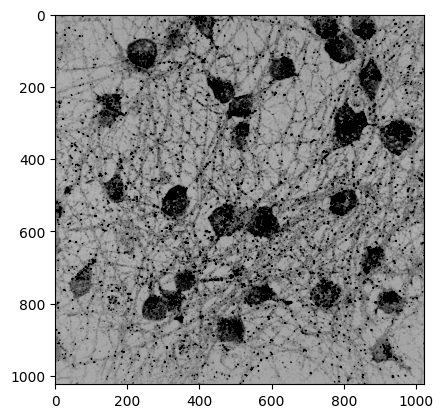

6478


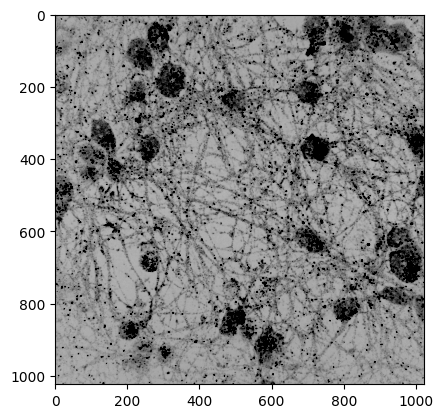

6483


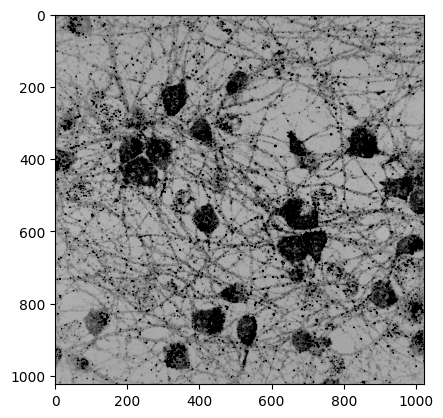

6484


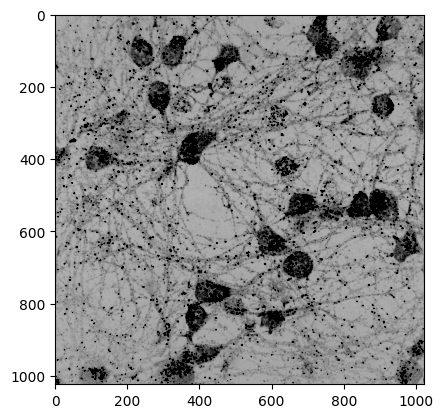

6485


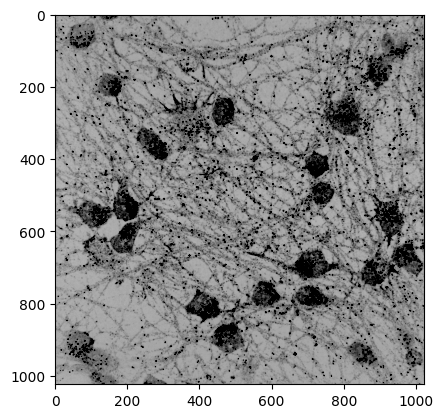

6489


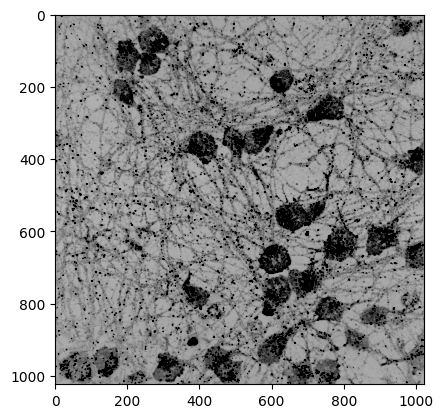

6491


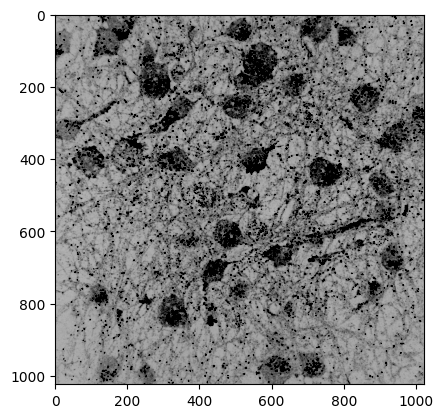

6811


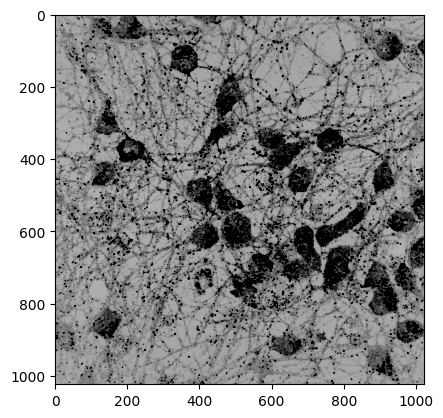

6814


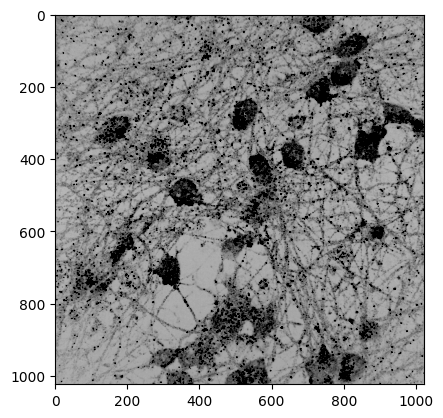

6823


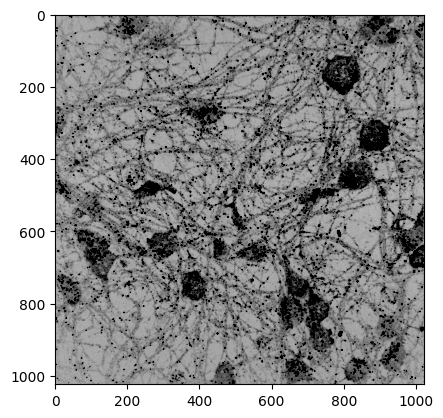

6825


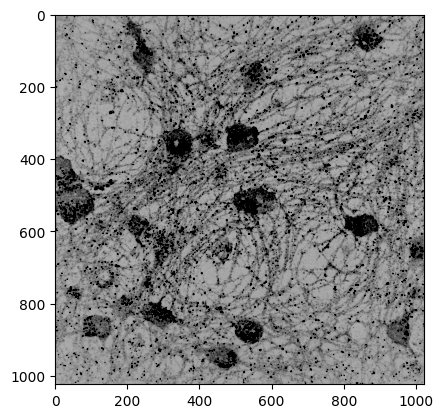

6828


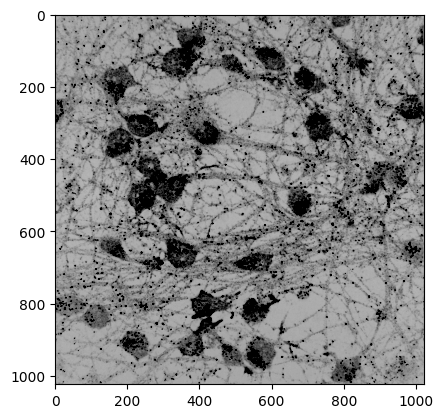

6843


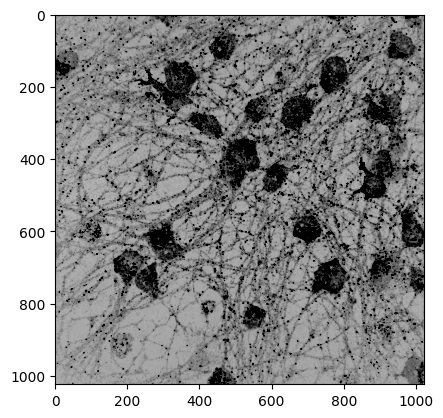

6845


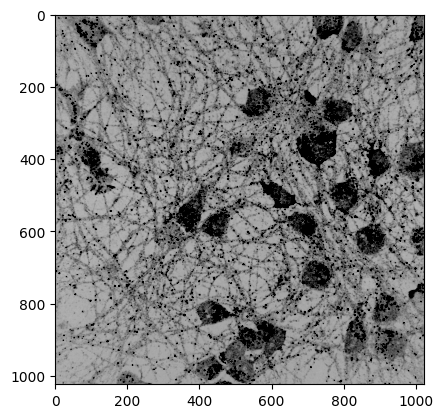

6846


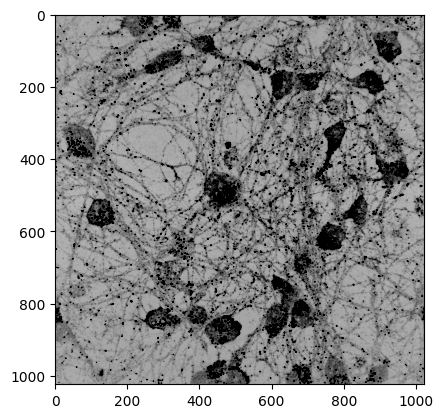

6847


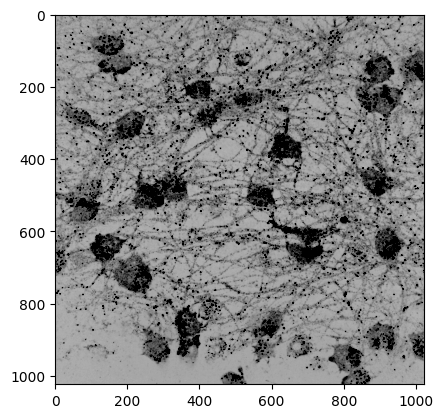

6857


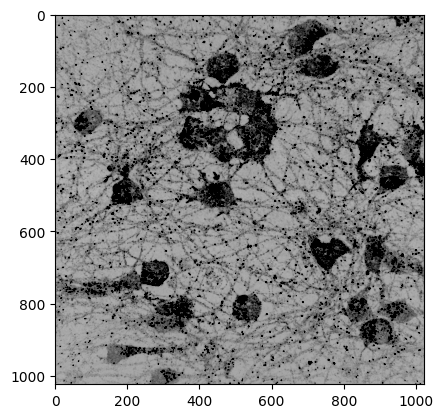

6860


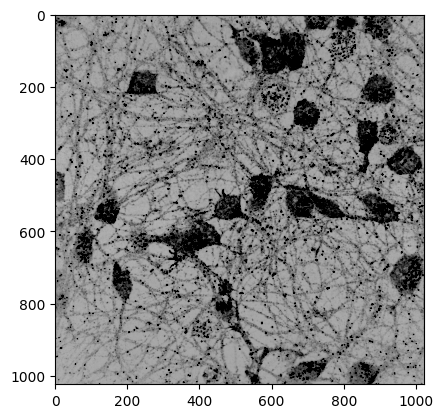

6865


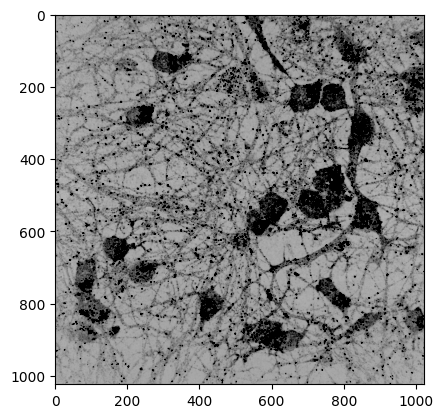

6866


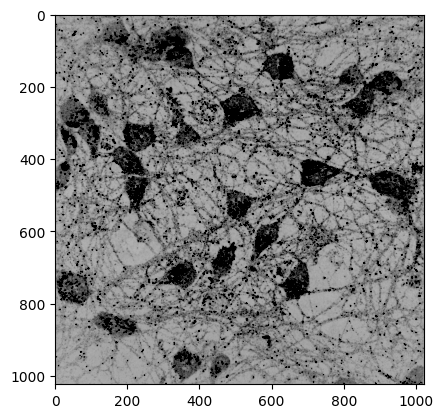

6869


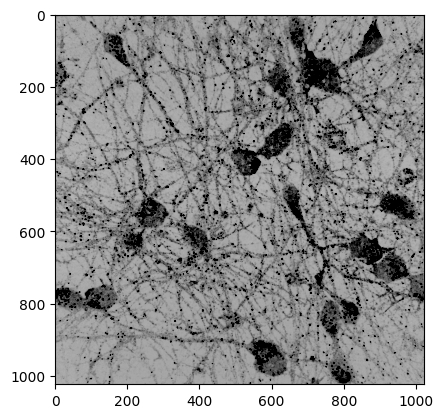

6871


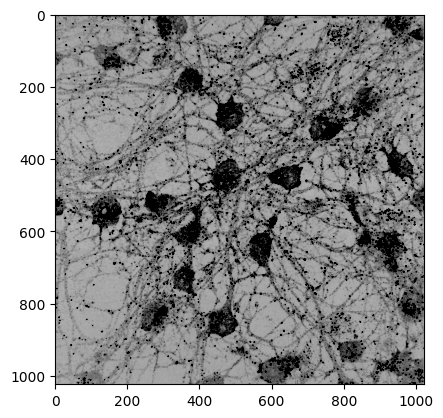

6872


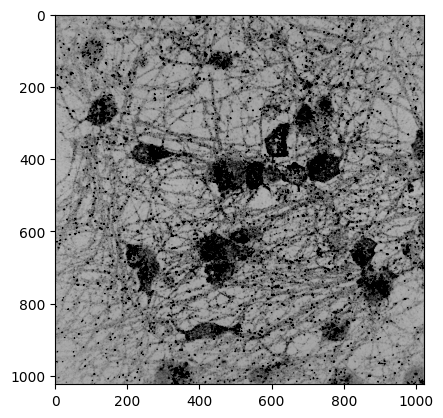

6874


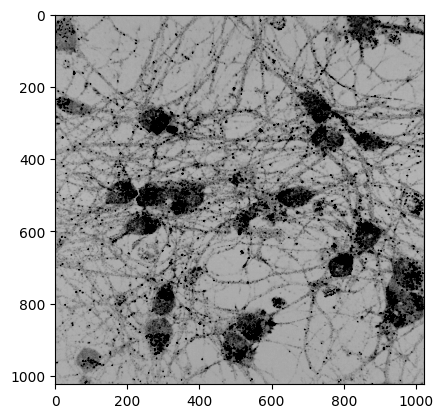

6885


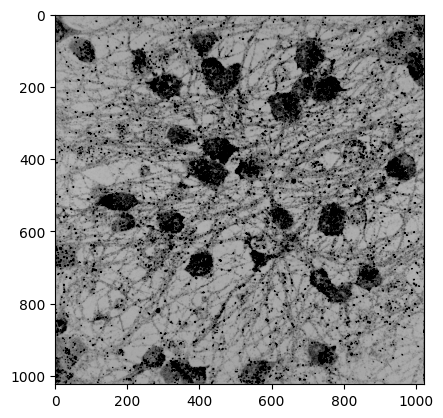

6888


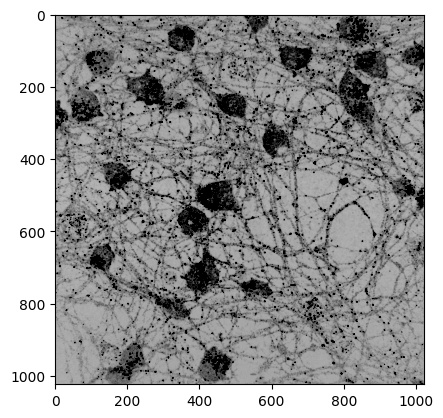

6895


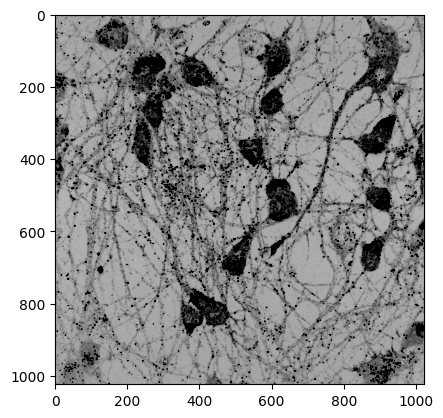

6896


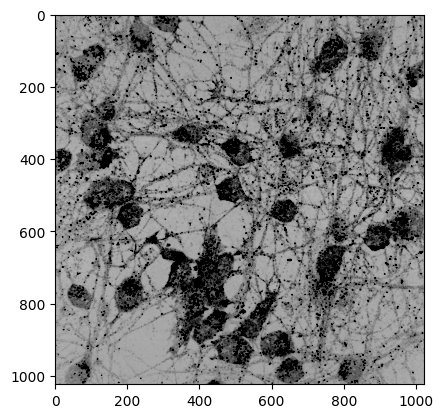

6899


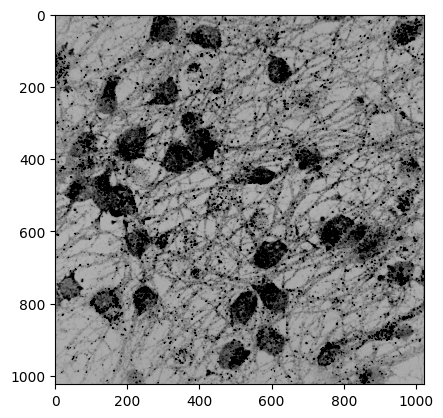

6909


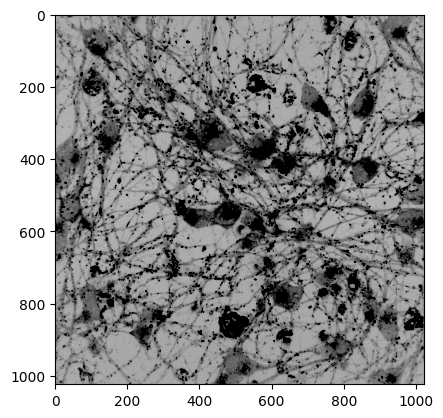

6932


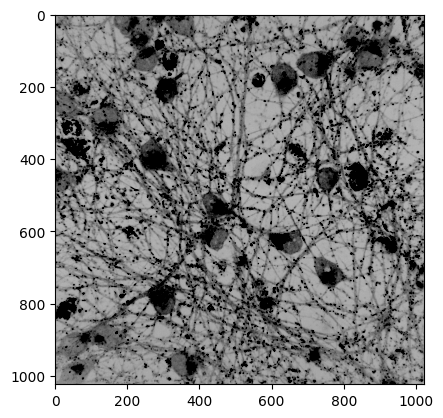

6936


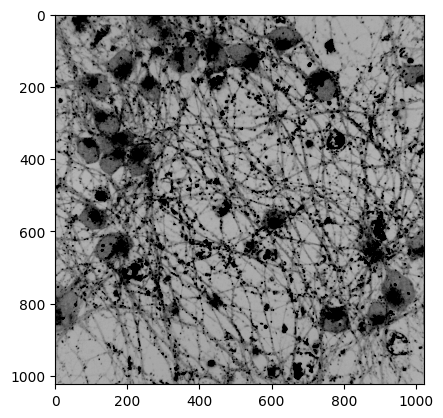

6969


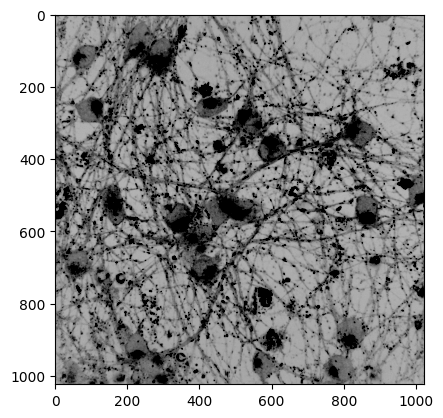

6975


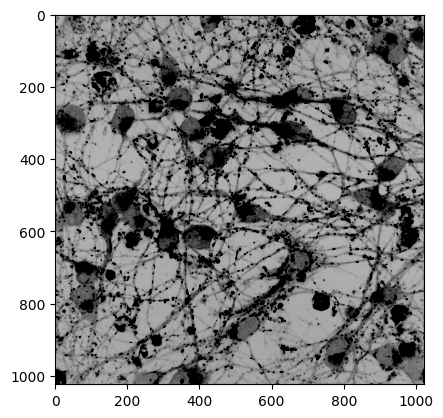

In [89]:
for ind in iso_outlier_indices:
    print(ind)
    if ind >= len(tiles):
        break
    img = tiles[ind]
    # marker = tiles['Path'].split(os.sep)[-2]
    # if marker != marker_to_select:
    #     continue
    plt.imshow(img, vmin=0, vmax=1000, cmap='Greys')
    plt.show()

------------

# MISC.

In [216]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_scaled = df.copy()
df_scaled.iloc[:,2:] = scaler.fit_transform(df.iloc[:,2:])
df_scaled

,ID,Quality,Target_Blurness,DAPI_Blurness
0,0,Normal,0.079847,0.148134
1,1,Normal,0.063483,0.035023
2,2,Normal,0.203639,0.244844
3,3,Normal,0.102316,0.060729
4,4,Normal,0.070320,0.024430
...,...,...,...,...
2021,55,Bad,0.502094,0.038469
2022,56,Bad,0.439549,0.253145
2023,57,Bad,0.726859,0.029899
2024,58,Bad,0.656059,0.159074


In [217]:
print(df.loc[:,['Quality','Target_Blurness']].groupby('Quality').mean())
print(df.loc[:,['Quality','DAPI_Blurness']].groupby('Quality').mean())


         Target_Blurness
Quality                 
Bad            78.593675
Normal         16.773649
         DAPI_Blurness
Quality               
Bad           3.673160
Normal        7.087766


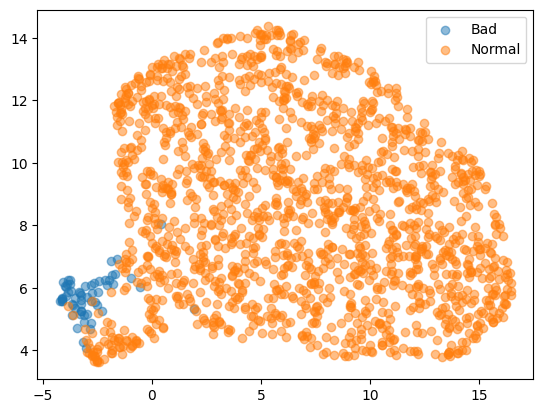

In [32]:
from umap import UMAP
reducer = UMAP(n_neighbors=50, min_dist=0.5, random_state=1)
umap_data = reducer.fit_transform(df.iloc[:,2:])

labels_unique = np.unique(df['Quality'])
for l in labels_unique:
    indexes = df.loc[df['Quality'] == l].index
    plt.scatter(umap_data[indexes,0], umap_data[indexes,1], alpha=0.5)
    
plt.legend(labels_unique)
plt.show()

/home/labs/hornsteinlab/Collaboration/MOmaps/anaconda3/momaps_torch/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


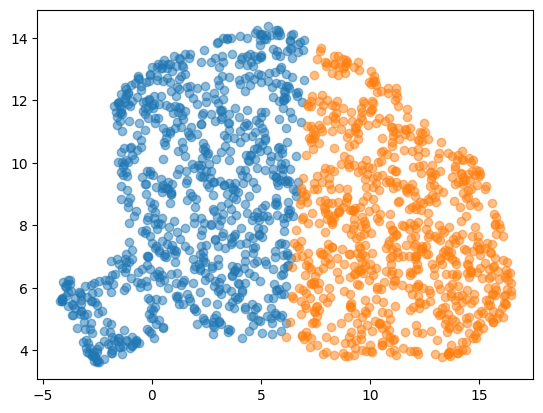

In [34]:
from sklearn.cluster import KMeans
kmeans = KMeans(2, random_state=1).fit(umap_data)
kmeans_labels = kmeans.labels_

labels_unique = np.unique(kmeans_labels)
for l in labels_unique:
    indexes = np.where(kmeans_labels == l)[0]
    plt.scatter(umap_data[indexes,0], umap_data[indexes,1], alpha=0.5)


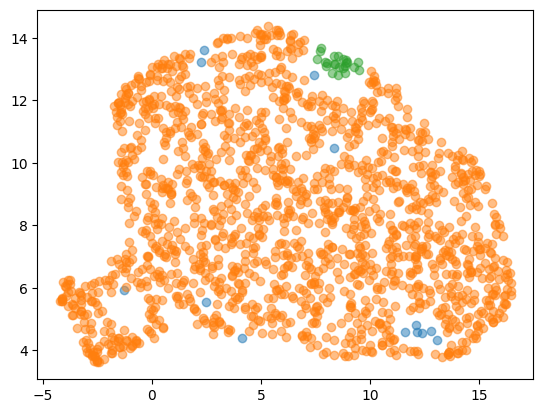

In [41]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5).fit(umap_data)
dbscan_labels = dbscan.labels_


labels_unique = np.unique(dbscan_labels)
for l in labels_unique:
    indexes = np.where(dbscan_labels == l)[0]
    plt.scatter(umap_data[indexes,0], umap_data[indexes,1], alpha=0.5)


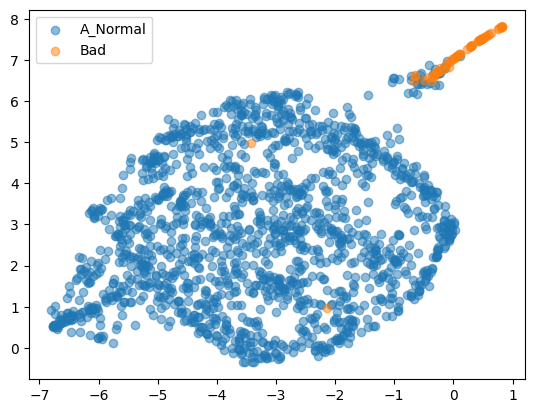

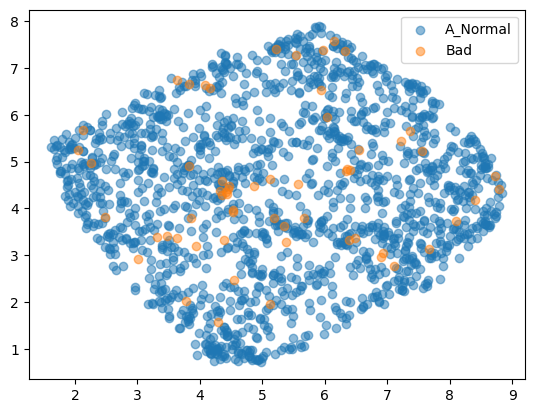

In [49]:
# run_PCA(site[...,1])
umap0 = run_dim_reduction(UMAP(random_state=1), np.stack([*site[...,0], *bad_tiles[...,0]]), np.asarray(['A_Normal']*len(site) + ['Bad']*len(bad_tiles)))
umap1 = run_dim_reduction(UMAP(random_state=1), np.stack([*site[...,1], *bad_tiles[...,1]]), np.asarray(['A_Normal']*len(site) + ['Bad']*len(bad_tiles)))

/home/labs/hornsteinlab/Collaboration/MOmaps/anaconda3/momaps_torch/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


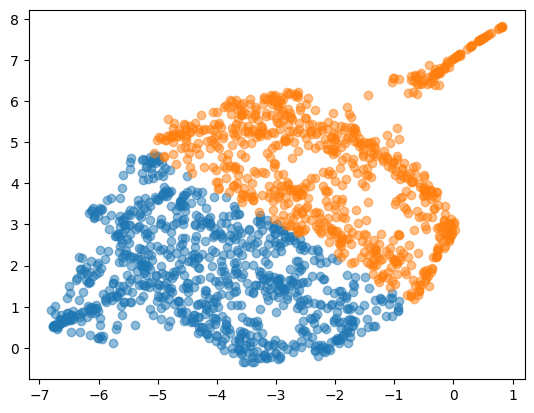

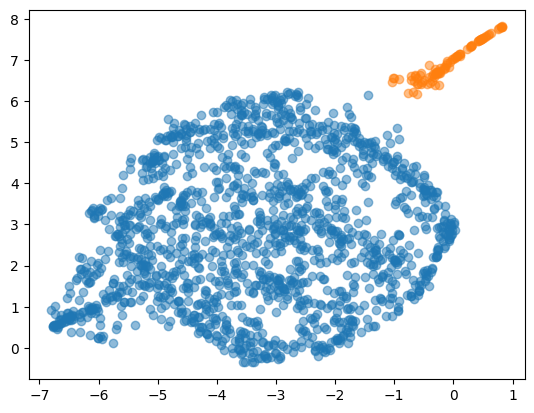

In [54]:
from sklearn.cluster import KMeans
kmeans = KMeans(2, random_state=1).fit(umap0)
kmeans_labels = kmeans.labels_

labels_unique = np.unique(kmeans_labels)
for l in labels_unique:
    indexes = np.where(kmeans_labels == l)[0]
    plt.scatter(umap0[indexes,0], umap0[indexes,1], alpha=0.5)

plt.show()


from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5).fit(umap0)
dbscan_labels = dbscan.labels_


labels_unique = np.unique(dbscan_labels)
for l in labels_unique:
    indexes = np.where(dbscan_labels == l)[0]
    plt.scatter(umap0[indexes,0], umap0[indexes,1], alpha=0.5)

plt.show()

In [72]:
# from sklearn.cluster import KMeans
# kmeans = KMeans(2, random_state=1).fit(df_scaled.iloc[:,2:])
# kmeans_labels = kmeans.labels_
# print(pd.Series(kmeans_labels).value_counts())

from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5).fit(df_scaled.iloc[:,2:])
dbscan_labels = dbscan.labels_
print(pd.Series(dbscan_labels).value_counts())

# labels_unique = np.unique(dbscan_labels)
# for l in labels_unique:
#     indexes = np.where(dbscan_labels == l)[0]
#     plt.scatter(umap0[indexes,0], umap0[indexes,1], alpha=0.5)


0    1616
Name: count, dtype: int64


Index(['DAPI_SNR', 'DAPI_Sharpness', 'DAPI_Contrast', 'DAPI_Var',
       'DAPI_Blurness'],
      dtype='object')

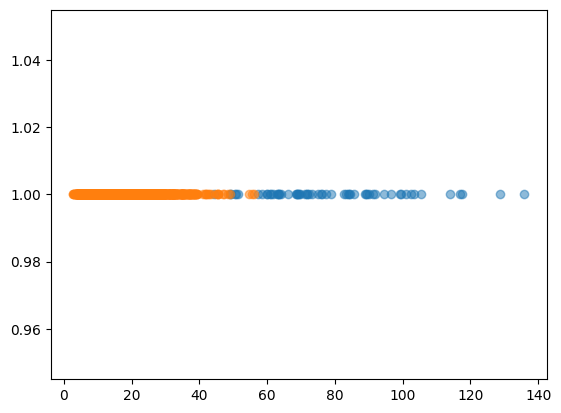

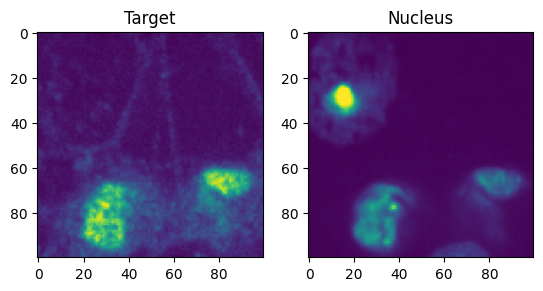

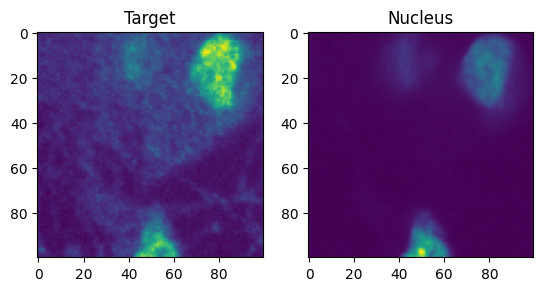

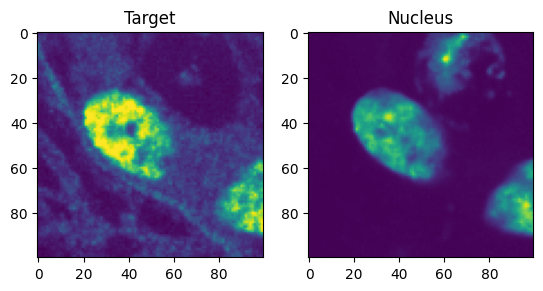

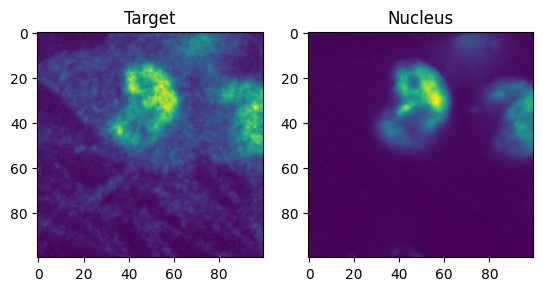

...

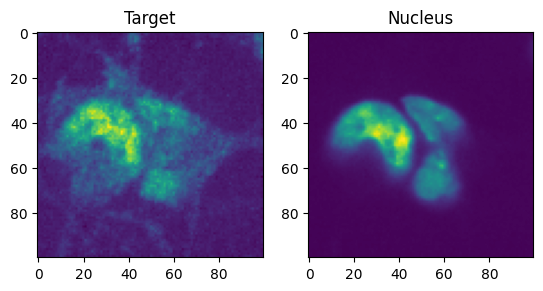

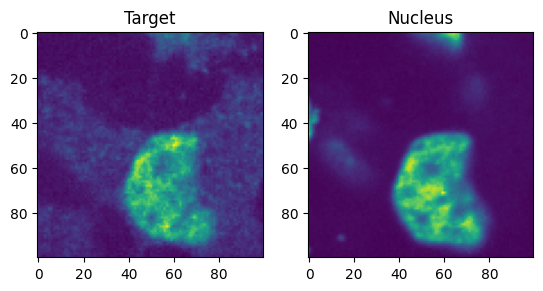

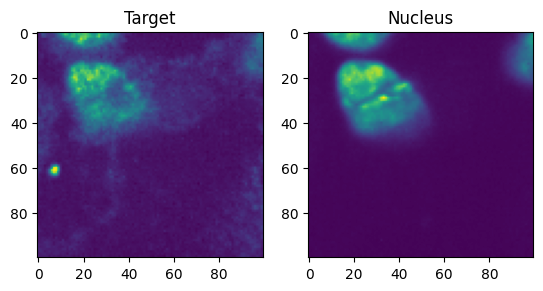

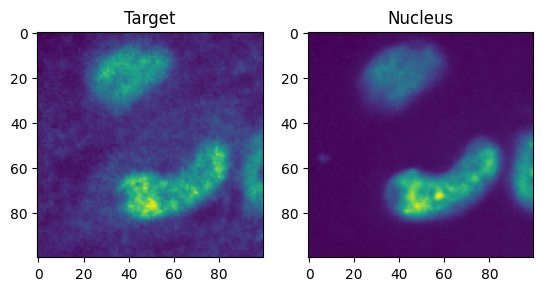

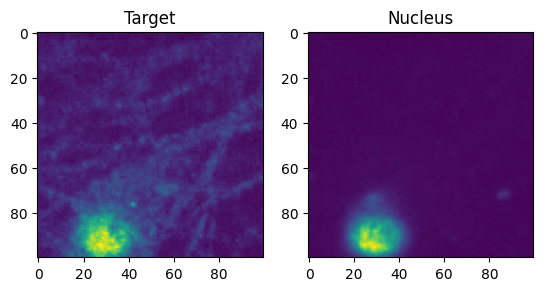

In [218]:
labels_unique = np.unique(df['Quality'])
for l in labels_unique:
    indexes = df['Quality'] == l
    # plt.scatter(umap_df[indexes,0], umap_df[indexes,1], alpha=0.5)
    plt.scatter(df.loc[indexes,'Target_Blurness'], np.ones(sum(indexes)), alpha=0.5)#, df_scaled.loc[:,'DAPI_Blurness'])
    
predicted_bad_images_ind = df.loc[df['Target_Blurness'] >= 70 ,'ID']
predicted_bad_images_ind = np.where(predicted_bad_images_ind.values < len(site))[0]

plot_images(site[predicted_bad_images_ind])



In [ ]:
run_dim_reduction(PCA(2), df_scaled.loc[:,df.columns[df.columns.str.contains("Target")]].to_numpy())


umap_df = run_dim_reduction(UMAP(), df_scaled.loc[:,df.columns[df.columns.str.contains("Target")]].to_numpy(), labels=df_scaled['Quality'])


/home/labs/hornsteinlab/Collaboration/MOmaps/anaconda3/momaps_torch/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


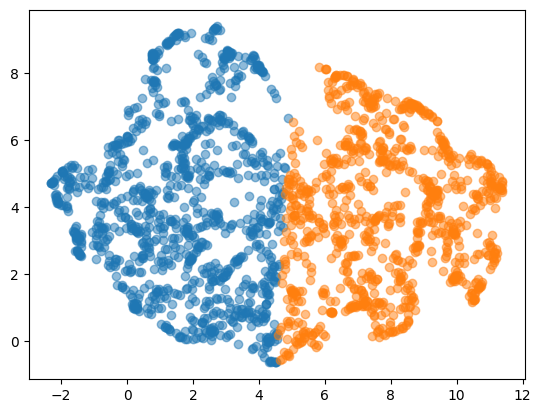

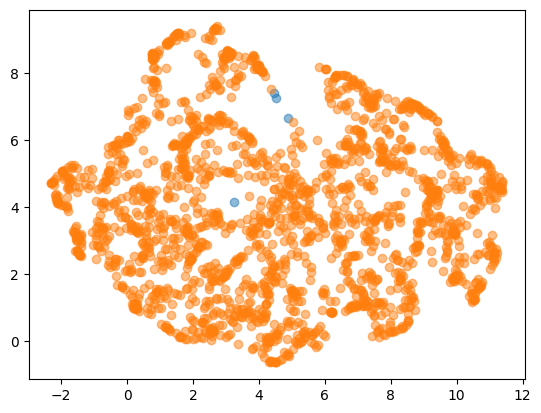

In [190]:
from sklearn.cluster import KMeans
kmeans = KMeans(2, random_state=1).fit(umap_df)
kmeans_labels = kmeans.labels_

labels_unique = np.unique(kmeans_labels)
for l in labels_unique:
    indexes = np.where(kmeans_labels == l)[0]
    plt.scatter(umap_df[indexes,0], umap_df[indexes,1], alpha=0.5)

plt.show()


from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5).fit(umap_df)
dbscan_labels = dbscan.labels_


labels_unique = np.unique(dbscan_labels)
for l in labels_unique:
    indexes = np.where(dbscan_labels == l)[0]
    plt.scatter(umap_df[indexes,0], umap_df[indexes,1], alpha=0.5)

plt.show()

In [106]:
print(pd.Series(dbscan_labels.reshape(-1,)).value_counts())
bad_indexes = np.where(dbscan_labels == 1)[0]
print(bad_indexes)
bad_indexes = np.where(bad_indexes < len(site))[0]
# all_data = np.stack([*site, *bad_tiles])
bad_predicted_images = site[bad_indexes]
print(bad_predicted_images.shape)
plot_images(bad_predicted_images)

0    1945
1      49
Name: count, dtype: int64
[1934 1935 1936 1937 1938 1939 1940 1941 1942 1943 1945 1946 1947 1948
 1949 1950 1951 1952 1953 1954 1955 1957 1958 1959 1960 1961 1962 1963
 1964 1965 1967 1969 1970 1971 1974 1975 1976 1977 1978 1979 1981 1982
 1983 1985 1986 1988 1989 1990 1991]
(0, 100, 100, 2)


## PCA

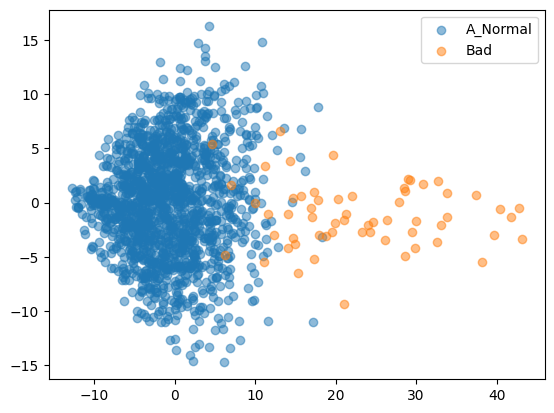

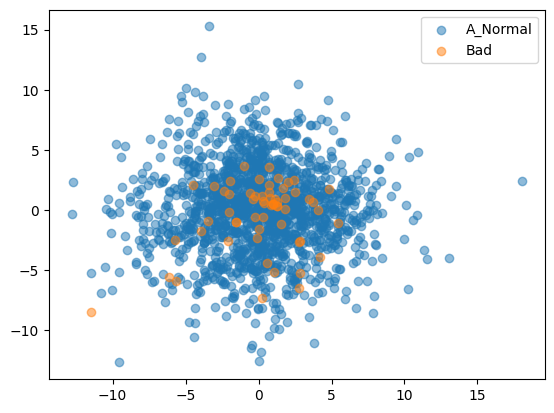

In [52]:
# run_PCA(site[...,1])
pca0 = run_dim_reduction(PCA(2), np.stack([*site[...,0], *bad_tiles[...,0]]), np.asarray(['A_Normal']*len(site) + ['Bad']*len(bad_tiles)))
pca1 = run_dim_reduction(PCA(2), np.stack([*site[...,1], *bad_tiles[...,1]]), np.asarray(['A_Normal']*len(site) + ['Bad']*len(bad_tiles)))

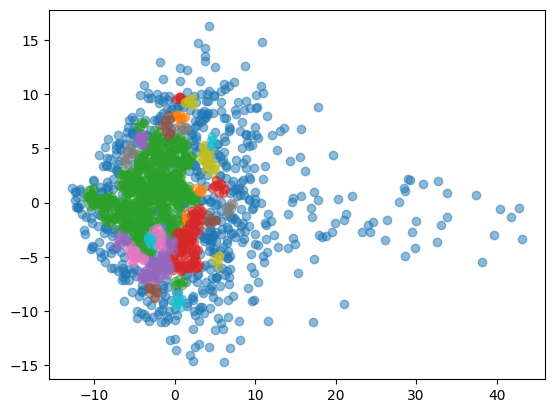

In [53]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5).fit(pca0)
dbscan_labels = dbscan.labels_


labels_unique = np.unique(dbscan_labels)
for l in labels_unique:
    indexes = np.where(dbscan_labels == l)[0]
    plt.scatter(pca0[indexes,0], pca0[indexes,1], alpha=0.5)

plt.show()

# fastdup

In [1]:
# import fastdup
# fd = fastdup.create(input_dir="./bad_tiles_new.npy")
# fd.run()